In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/military-aircraft-recognition-dataset/Annotations/Oriented Bounding Boxes/3468.xml
/kaggle/input/military-aircraft-recognition-dataset/Annotations/Oriented Bounding Boxes/1853.xml
/kaggle/input/military-aircraft-recognition-dataset/Annotations/Oriented Bounding Boxes/1317.xml
/kaggle/input/military-aircraft-recognition-dataset/Annotations/Oriented Bounding Boxes/1159.xml
/kaggle/input/military-aircraft-recognition-dataset/Annotations/Oriented Bounding Boxes/2803.xml
/kaggle/input/military-aircraft-recognition-dataset/Annotations/Oriented Bounding Boxes/3198.xml
/kaggle/input/military-aircraft-recognition-dataset/Annotations/Oriented Bounding Boxes/3370.xml
/kaggle/input/military-aircraft-recognition-dataset/Annotations/Oriented Bounding Boxes/2342.xml
/kaggle/input/military-aircraft-recognition-dataset/Annotations/Oriented Bounding Boxes/1151.xml
/kaggle/input/military-aircraft-recognition-dataset/Annotations/Oriented Bounding Boxes/1605.xml
/kaggle/input/military-aircraf

# **Предварительные манипуляции**

# **1. Загрузка необходимых модулей**

In [2]:
# %%capture
#!python -m venv env #создает отдельную среду для работы над разными проектами
!pip install split-folders # разбивает данные по папкам train, val, test
# !pip install colorama
!pip install torchinfo
!pip install -q --upgrade selectivesearch torch_snippets
!pip install -q torch_snippets

In [3]:
%%capture
import os
import cv2
import tqdm
import torch
import shutil
import numpy as np
import splitfolders
import pandas as pd
from PIL import Image
import selectivesearch
from IPython import display
from torchinfo import summary
from torch_snippets import * #не дает сделать цветной вывод
from torchvision.ops import nms
import matplotlib.pyplot as plt
from torch.optim import SGD, Adam
# from torch_snippets import Report, Glob, show, read
import xml.etree.ElementTree as et
# from colorama import Fore,Back,Style,init
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, models, datasets
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
device = 'cuda' if torch.cuda.is_available() else 'cpu'
import matplotlib.patches as patches
from torch import nn

In [4]:
# torch.cuda.empty_cache()

# **2. Загрузка данных**

In [5]:
# !mkdir -p ~/.kaggle
# !mv kaggle.json ~/.kaggle/
# !ls ~/.kaggle
# !chmod 600 /root/.kaggle/kaggle.json
# !kaggle datasets download -d khlaifiabilel/military-aircraft-recognition-dataset/

# **3. Создаем DataFrame с данными**

In [6]:
images = '/kaggle/input/military-aircraft-recognition-dataset/JPEGImages'
annotations_4 = '/kaggle/input/military-aircraft-recognition-dataset/Annotations/Horizontal Bounding Boxes'
# annotations_8 = '/content/Annotations/Oriented Bounding Boxes'

In [7]:
images_paths = sorted([str(i) for i in Glob(f'{images}/*.jpg')])
len(images_paths)

3842

In [8]:
annotation_paths_4 = sorted([str(i) for i in Glob(f'{annotations_4}/*.xml')])
len(annotation_paths_4)
#annotation_paths_4

3842

In [9]:
picture =[]
way_pic =[]
way_ann =[]
target = []
X_left = []
Y_down = []
X_right = []
Y_up = []
width = []
height = []
for i,j in enumerate(annotation_paths_4):
  tree = et.parse(j)
  #root = tree.getroot()
  pic_name = images_paths[i].split('/')[-1][:-4]
  for el in tree.findall('object'):
    picture.append(f'{pic_name}.jpg')
    way_ann.append(j)
    way_pic.append(images_paths[i])
    target.append(el.find('name').text)
    X_left.append(el.find('bndbox').find('xmin').text)
    Y_down.append(el.find('bndbox').find('ymin').text)
    X_right.append(el.find('bndbox').find('xmax').text)
    Y_up.append(el.find('bndbox').find('ymax').text)
    for _ in tree.findall('size'):
      ww = _.find('width').text
      hh = _.find('height').text
      width.append(ww)
      height.append(hh)
    #X_left,Y_down,X_right,Y_up = [X_left / ww, Y_down / hh, X_right / ww, Y_up / hh]

name_col = ['ImageID', 'LabelName', 'X_left', 'Y_down', 'X_right', 'Y_up','width','height', 'way_pic', 'way_ann']
lst = picture, target, X_left, Y_down, X_right, Y_up, width, height, way_pic, way_ann
df = pd.DataFrame(np.column_stack(lst), columns = name_col)
DF_RAW = df = df[df.ImageID.str.contains('.jpg')]

df.X_left = np.around((df.X_left.astype(float)/df.width.astype(float)),6)
df.X_right = np.around(df.X_right.astype(float)/df.width.astype(float),6)
df.Y_down = np.around(df.Y_down.astype(float)/df.height.astype(float),6)
df.Y_up = np.around(df.Y_up.astype(float)/df.height.astype(float),6)
#df[['XMin','XMax']] = df[['XMin','XMax']].astype(float)/df[['width','width']].astype(float)
#df[['YMin','YMax']] = df[['YMin','YMax']].astype(float)/df[['height']]
df.sample(4)

,ImageID,LabelName,X_left,Y_down,X_right,Y_up,width,height,way_pic,way_ann
15480,3499.jpg,A17,0.227500,0.376250,0.320000,0.467500,800,800,/kaggle/input/military-aircraft-recognition-da...,/kaggle/input/military-aircraft-recognition-da...
20583,742.jpg,A3,0.538653,0.586493,0.645885,0.699052,802,844,/kaggle/input/military-aircraft-recognition-da...,/kaggle/input/military-aircraft-recognition-da...
2258,1377.jpg,A14,0.115000,0.346250,0.361250,0.580000,800,800,/kaggle/input/military-aircraft-recognition-da...,/kaggle/input/military-aircraft-recognition-da...
18731,497.jpg,A18,0.758178,0.768838,0.849299,0.872286,856,783,/kaggle/input/military-aircraft-recognition-da...,/kaggle/input/military-aircraft-recognition-da...


In [10]:
df = DF_RAW = df[df.X_left != np.inf]

# **4. Смотрим картинки с коробками и метками**

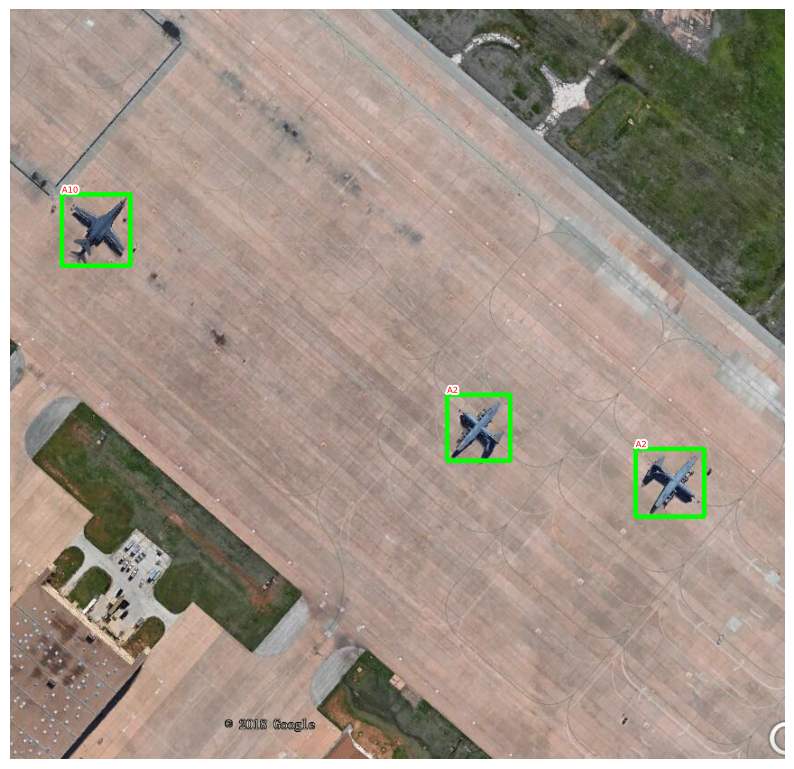

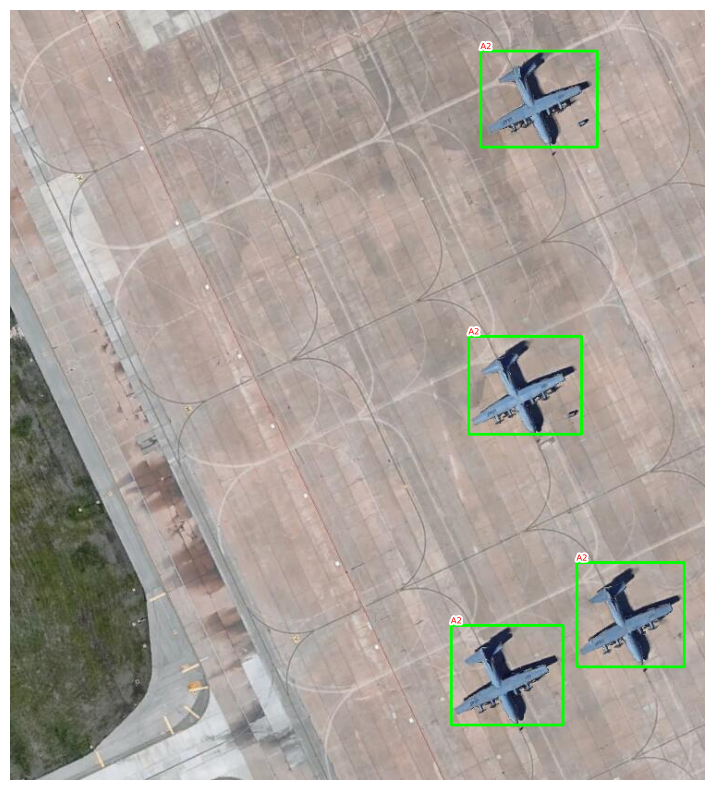

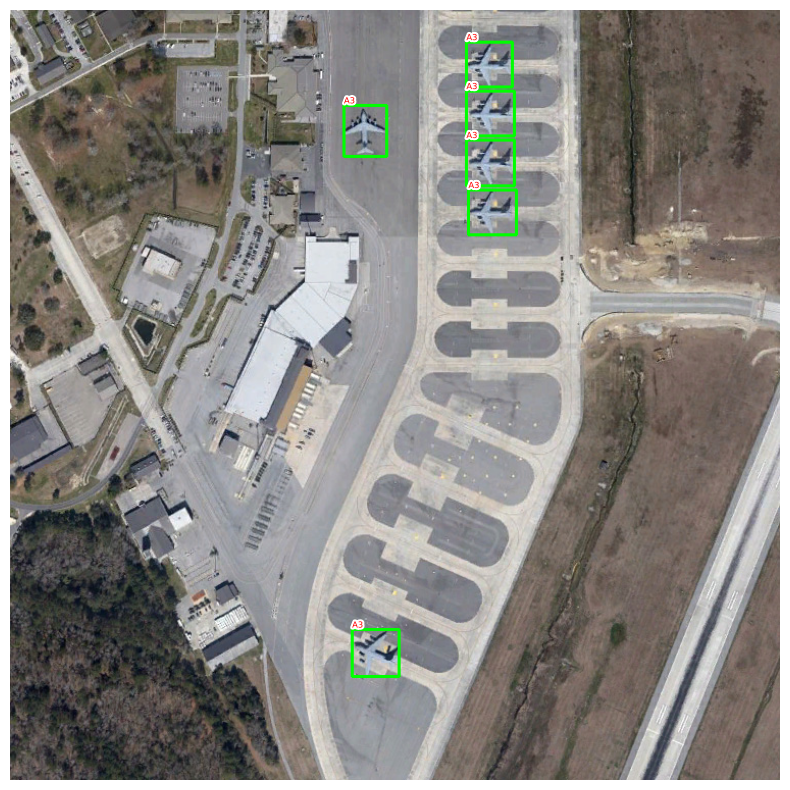

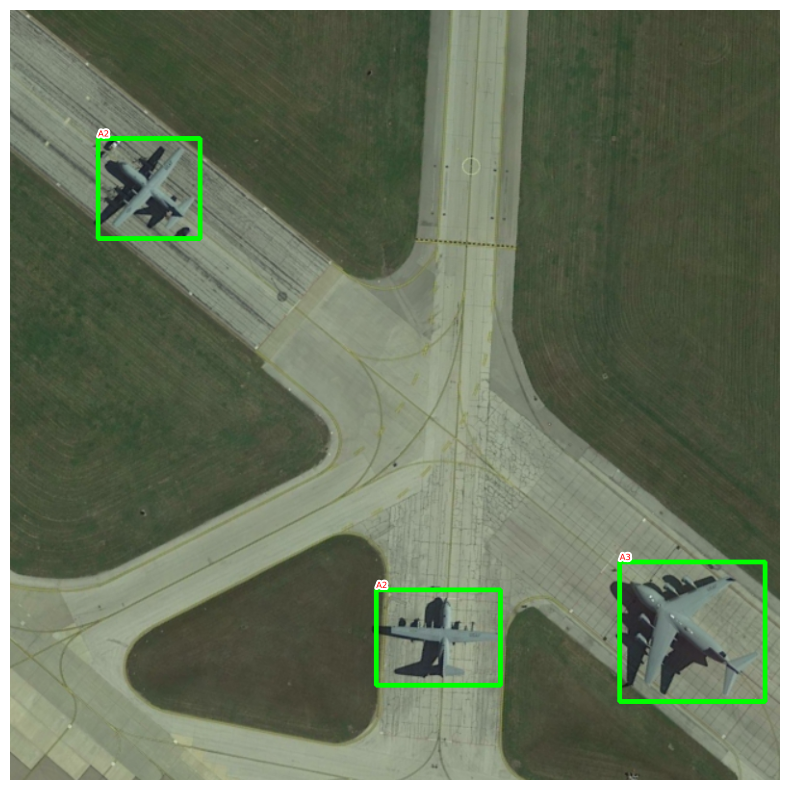

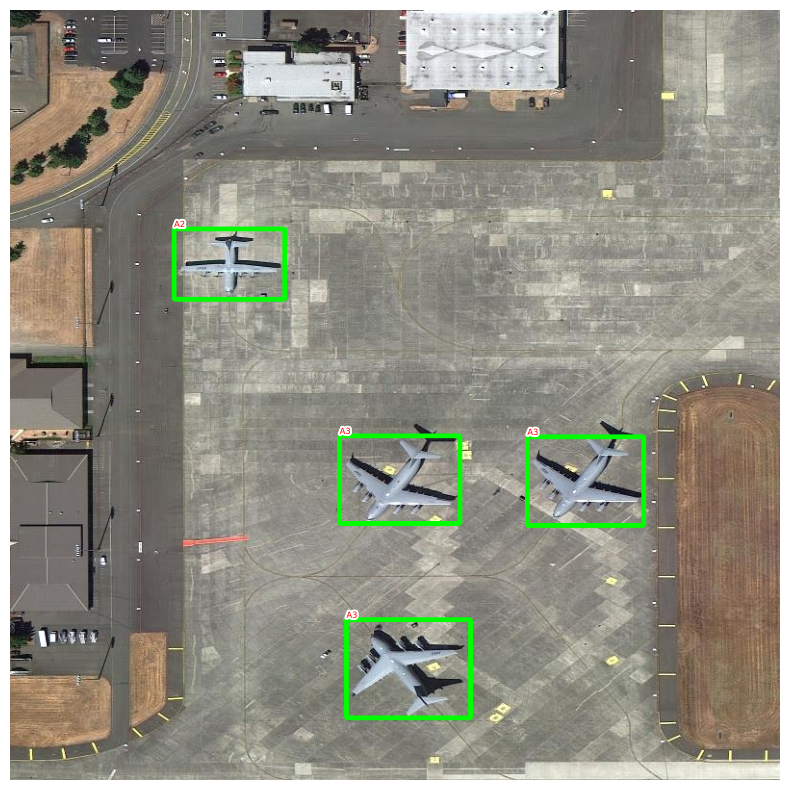

...

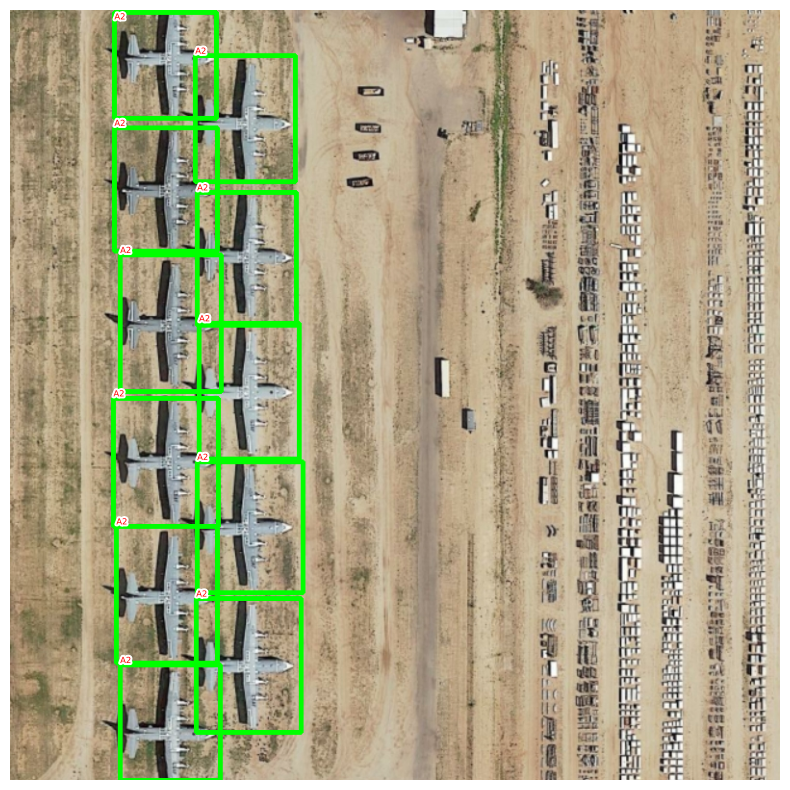

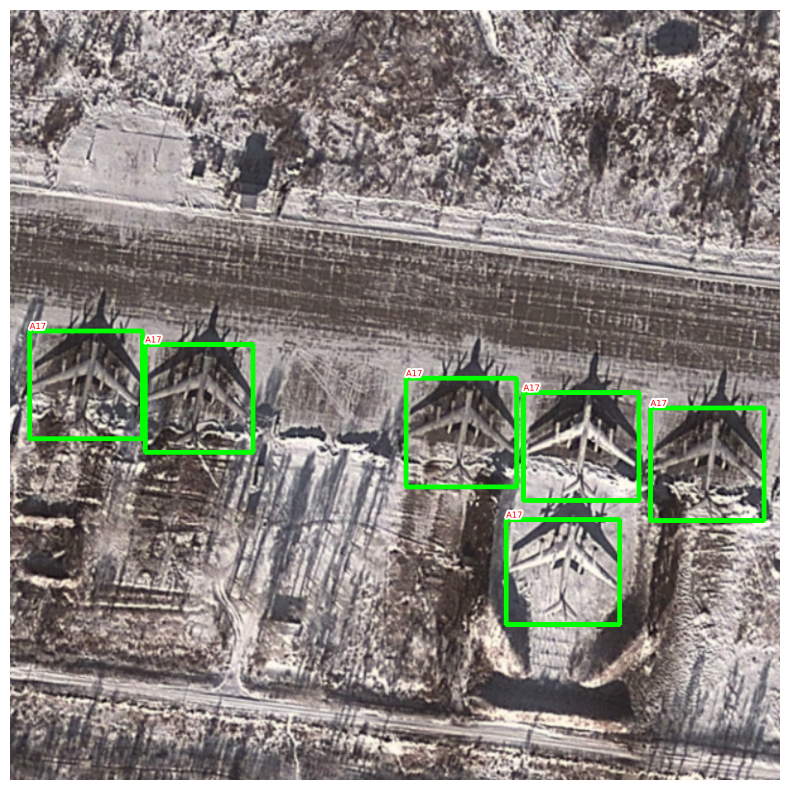

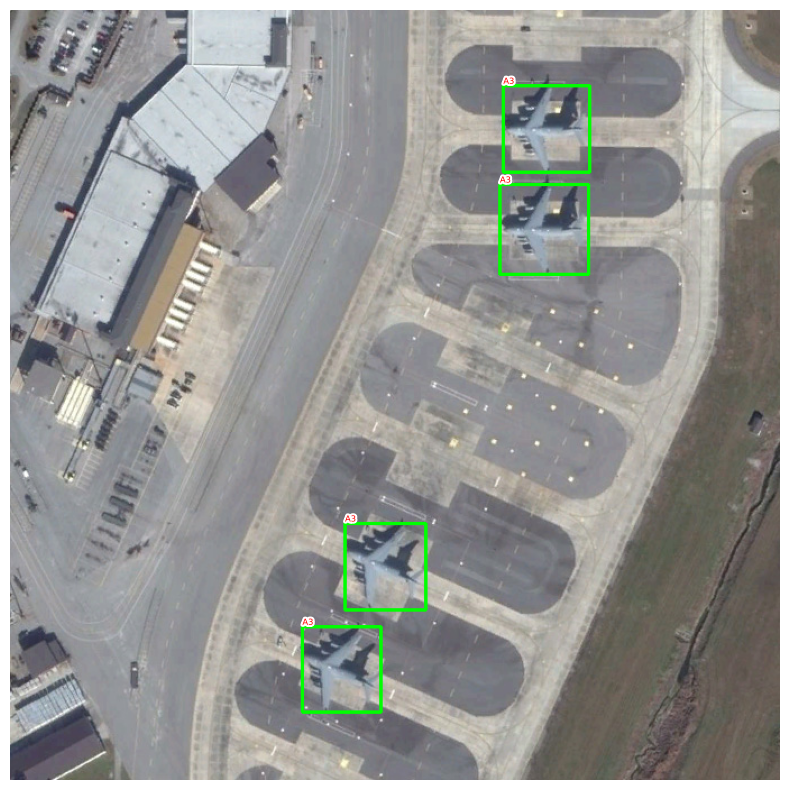

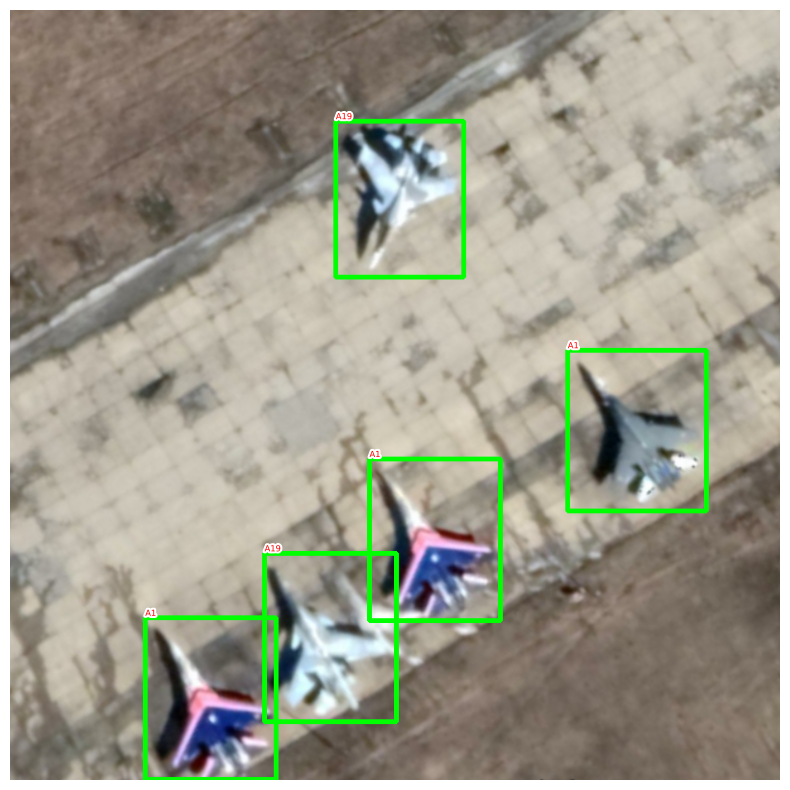

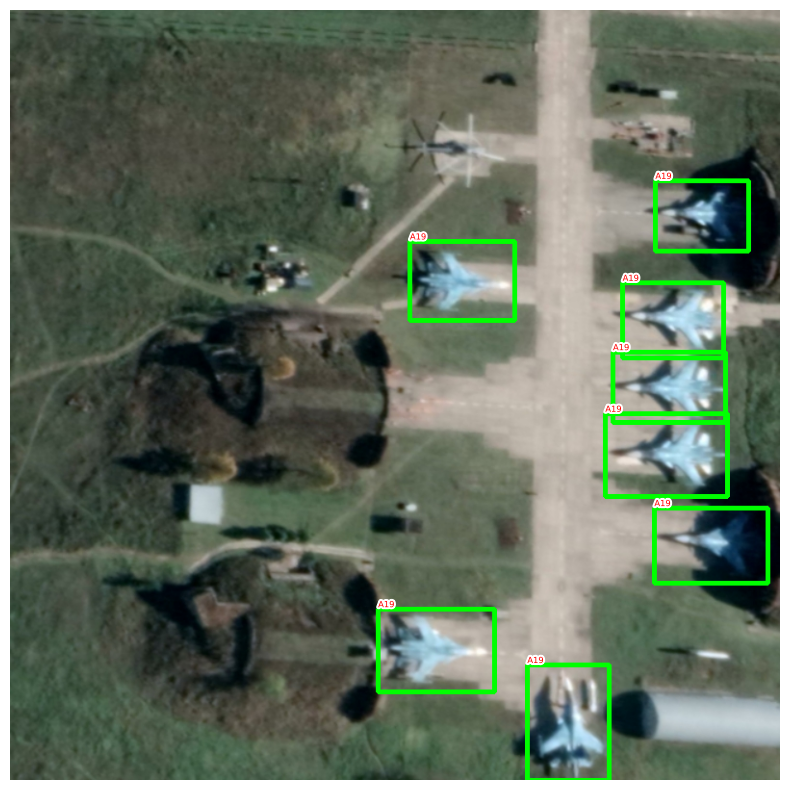

In [11]:
class OpenImages(Dataset):
    def __init__(self, df, image_folder='/kaggle/input/military-aircraft-recognition-dataset/JPEGImages/'):
        self.root = image_folder
#        self.root = [str(i) for i in self.root]
        self.df = df
        self.unique_images = df['ImageID'].unique()
    def __len__(self): return len(self.unique_images)
    def __getitem__(self, ix):
        image_id = self.unique_images[ix]
        image_path = f'{self.root}/{image_id}'
      #  print(image_path)
        image = cv2.imread(image_path, 1)[...,::-1]#.convert('RGB') # conver BGR to RGB
#        print(image.shape)
        #print(image)
        h, w, _ = image.shape
        df = self.df.copy()
        df = df[df['ImageID'] == image_id]
        boxes = df['X_left,Y_down,X_right,Y_up'.split(',')].values
        boxes = (boxes * np.array([w,h,w,h])).astype(np.uint16).tolist()
        classes = df['LabelName'].values.tolist()
        return image, boxes, classes, image_path
#for i,j in DF_RAW.head(4).iterrows():
ds = OpenImages(df=DF_RAW)
for _,i in enumerate(ds):
  if _ > 15: break
  else:
    im, bbs, clss, _ = i
    show(im, bbs=bbs, texts=clss, sz=10)

# **5. Создаем Классы и кодируем**

In [12]:
# если данные в VOC-format (.xml), то поступаем так:
def Classes(df):
    #LabelName = df.LabelName.unique().to_list()
    list_classes = list(df.LabelName.unique())
    list_classes.sort()
    list_classes.insert(0, 'background') # вставляет элемент в нулевую позицию
    label2targets = {l: t for t, l in enumerate(list_classes)}
    targets2label = {t: l for l, t in label2targets.items()}
    num_classes = len(targets2label)
    return label2targets, targets2label, num_classes
label2targets, targets2label, num_classes = Classes(df)

print(label2targets)
print(targets2label)
print(num_classes)

{'background': 0, 'A1': 1, 'A10': 2, 'A11': 3, 'A12': 4, 'A13': 5, 'A14': 6, 'A15': 7, 'A16': 8, 'A17': 9, 'A18': 10, 'A19': 11, 'A2': 12, 'A20': 13, 'A3': 14, 'A4': 15, 'A5': 16, 'A6': 17, 'A7': 18, 'A8': 19, 'A9': 20}
{0: 'background', 1: 'A1', 2: 'A10', 3: 'A11', 4: 'A12', 5: 'A13', 6: 'A14', 7: 'A15', 8: 'A16', 9: 'A17', 10: 'A18', 11: 'A19', 12: 'A2', 13: 'A20', 14: 'A3', 15: 'A4', 16: 'A5', 17: 'A6', 18: 'A7', 19: 'A8', 20: 'A9'}
21


# **6. Компануем данные для подачи в Dataloader**

In [13]:
import collections, os, torch
from PIL import Image
from torchvision import transforms
normalize = transforms.Normalize(
    mean=[0.485, 0.456, 0.406],
    std=[0.229, 0.224, 0.225]
)
denormalize = transforms.Normalize(
    mean=[-0.485/0.229, -0.456/0.224, -0.406/0.255],
    std=[1/0.229, 1/0.224, 1/0.255]
)

def preprocess_image(img):
    img = torch.tensor(img).permute(2,0,1)
    img = normalize(img)
    return img.to(device).float()

#from matplotlib import image
def preprocess_img(img):
    img = torch.tensor(img).permute(2, 0 ,1)
    return img.float()


class OpenDataset(torch.utils.data.Dataset):
    def __init__(self, roo, transforms=None):
        self.root = roo # DataFrame
        self.transforms = transforms # трансформации
        self.img_paths = [i for i in self.root.way_pic.unique()]
        # self.img_paths = self.root.way_pic.to_list() # список путей до картинок
        # print(len(self.img_paths))
        self.xlm_paths = [i for i in self.root.way_ann.unique()] # список путей до аннотаций
        # print(len(self.xlm_paths))
        self.image_infos = [i.split('/')[-1][-4] for i in self.root.ImageID.unique()]  # список имен картинок (без расширения)
        # print(len(self.image_infos))
        # logger.info(f'{len(self)} items loaded')
    def __getitem__(self, idx):
        #----------------------
        # достаем факт размер картинки (почему-то 2 канала)
        w, h = 300, 300
        img_path = self.img_paths[idx]
        xlm_path = self.xlm_paths[idx]
        img = Image.open(img_path).convert('RGB')
        W, H = img.size
        #----------------------
        # достаем картинку, меняем размер (появляются 3-й канала)
        img = np.array(img.resize((w, h),
                       resample=Image.Resampling.BILINEAR))/255.
        #print(img.shape)
        #print(img)
        #----------------------
        # достаем коробки, метки и компануем в словарь
        xlm = et.parse(xlm_path)
        objects = xlm.findall('object')
        labels = []
        boxes = []
        for obj in objects:
            XMin = float(obj.find('bndbox').find('xmin').text)
            YMin = float(obj.find('bndbox').find('ymin').text)
            XMax = float(obj.find('bndbox').find('xmax').text)
            YMax = float(obj.find('bndbox').find('ymax').text)
            bbox = [XMin / W, YMin / H, XMax / W, YMax / H]
            bbox = (bbox * np.array([w, h, w, h])).astype(np.int16).tolist()
            #---------------------------------------------------
            # условная вставка, которая удаляет нулевые и близкие к нулю коробки
            if (bbox[2] - bbox[0]) < 0.005 or (bbox[3] - bbox[1]) < 0.005: continue
            else:
            #---------------------------------------------------
              boxes.append(bbox)
              label = obj.find('name').text
              labels.append(label)

        labels = torch.tensor([label2targets[label] for label in labels]).long()
        boxes = torch.tensor(boxes).float()
        img = preprocess_img(img)
        #----------------------
        return img, boxes,labels

    def collate_fn(self, batch):
        images, boxes, labels = [], [], []
        for item in batch:
            img, image_boxes, image_labels = item
            img = img[None]
            #img = preprocess_image(img)[None]
            images.append(img)
            boxes.append(image_boxes.to(device)/300.)
            labels.append(image_labels.to(device))
        images = torch.cat(images).to(device)
        return images, boxes, labels
    def __len__(self):
        return len(self.image_infos)

# **7. Блок трансформации**

In [14]:
import albumentations as A
from albumentations.pytorch.transforms import ToTensorV2
def get_transform(train):
    if train:
        return A.Compose([
            A.HorizontalFlip(0.5),
            A.VerticalFlip(0.3),
            ToTensorV2(p=1.0)
        ], bbox_params={'format': 'pascal_voc', 'label_fields': ['labels']})
    else:
        return A.Compose([
            ToTensorV2(p=1.0)
        ], bbox_params={'format': 'pascal_voc', 'label_fields': ['labels']})

# **8. train_test_split**

In [15]:
# Разбивка данных на основе столбца с именами картинок в df
from sklearn.model_selection import train_test_split
trn_ids, val_ids = train_test_split(df.ImageID.unique(), test_size=0.1, random_state=99)
# trn_ids = list(trn_ids)
# val_ids = list(val_ids)
# типа разбивка df на train_df и val_df на основе разбивки train_test_split
trn_df, val_df = df[df['ImageID'].isin(trn_ids)], df[df['ImageID'].isin(val_ids)]
#print(trn_df, val_df)
len(trn_df), len(val_df)

(20003, 2215)

# **9. Создаем загрузчики**

In [16]:
train_ds = OpenDataset(trn_df)#, transforms=get_transform(train=False)) # False True
train_dl = DataLoader(train_ds, batch_size=8, shuffle=True, collate_fn=train_ds.collate_fn)

val_ds = OpenDataset(val_df)#, transforms=get_transform(train=False))
val_dl = DataLoader(val_ds, batch_size=8, shuffle=True, collate_fn=val_ds.collate_fn, drop_last=True)

# test_ds = OpenDataset(test)#, transforms=get_transform(train=False))
# test_dl = DataLoader(test_ds, batch_size=10, shuffle=True, collate_fn=val_ds.collate_fn, drop_last=True)

# img, boxs, labs = train_ds[70]
# plot_img_bbox(img.permute(1,2,0), boxs)
#show(img)

# **10. Функция mAP**

Здесь 4 функции:

in_for_mAP_true: преобразует форму батча в список списков для подачи в функцию mean_average_precision

in_for_mAP_pred: преобразует форму предсказанных моделью значений (boxes, labels,scores) в список списков для подачи в функцию mean_average_precision

insert_over_union: считает IoU, используется в теле mean_average_precision

mean_average_precision: вычисляет mAP

# **true_boxes:**

в формат: индекс_картинкивбатче, класс_самолета, степень_точночти, Xmin, Ymin, Xmax, Ymax

In [17]:
# рабочая для входов
def in_for_mAP_true(batch):
  lst_boxes=batch[1]
  lst_labels=batch[2]
  lst = list(zip(lst_labels,lst_boxes))
  ground_date=[]
  for i,_ in enumerate(lst):
    t=list(zip(_[0],_[1]))
    # print(t)
    lst_data =[]
    for k in t:
      f=[i,k[0]]
      f.extend(k[1])
      f.insert(2,float(1))
      lst_data.append([np.around(float(i),4) for i in f])
    ground_date.extend(lst_data)
  for i in ground_date:
    i[0] = int(i[0])
    i[1] = int(i[1])
  return ground_date

# **pred_bboxes:**

In [18]:
# рабочая для выходов
def in_for_mAP_pred(boxes, labels, confs):
  # print(boxes)
  # print(labels)
  # print(confs)
  pred_date=[]
  t=list(zip(labels, confs, boxes))
  for _,i in enumerate(t):
    out = list(zip(i[0], i[1], i[2]))
    lst_data =[]
    for j in out:
      f=[_,int(j[0]),round(float(j[1]),3)]
      f.extend([round(float(x),3) for x in j[2]])
      lst_data.append(f)
    pred_date.extend(lst_data)
  return pred_date

# **Функция mAP и insert_over_union:**

In [19]:
import torch
from collections import Counter

def mean_average_precision(pred_bboxes, true_boxes, iou_threshold=0.1, num_classes=20): #box_format="midpoint", - добавить к параметрам, если

    #pred_bboxes(list): [[train_idx,class_pred,prob_score,x1,y1,x2,y2], ...]

    average_precisions=[]#Пустой список для AP
    epsilon=1e-6#коэффициент для избежания ошибок

    #Для каждой категории!!!!!!!!!!!
    for c in range(num_classes):
        detections=[]#Store bbox predicted for this category
        ground_truths=[]#Storage itself is bbox(GT) of this category

        for detection in pred_bboxes: # список данных для pred (предсказаний)
            if detection[1]==c:
                detections.append(detection)

        for true_box in true_boxes: # список данных для true (исходных коробок)
            if true_box[1]==c:
                ground_truths.append(true_box)

        #img 0 has 3 bboxes
        #img 1 has 5 bboxes
        #It's like this: amount_bboxes={0:3,1:5}
        #Count the number of real boxes in each picture_ IDX indicates the number of the image to distinguish each image
        amount_bboxes=Counter(gt[0] for gt in ground_truths) # создаем amount_bboxes={0:3,1:5}

        for key,val in amount_bboxes.items(): #изменяем amount_bboxes в amount_bboxes={0:torch.tensor([0,0,0]),1:torch.tensor([0,0,0,0,0])}
            amount_bboxes[key]=torch.zeros(val)#Set to 0, which means that none of these real boxes initially matches any prediction box


        #Rank the prediction boxes in order of confidence
        detections.sort(key=lambda x:x[2],reverse=True) # сортируем от 1 до 0 по степени уверенности модели в своих предсказаниях

        #Initialize TP,FP
        TP=torch.zeros(len(detections)) # создаем нулевой тензор TP
        FP=torch.zeros(len(detections)) # создаем нулевой тензор FP

        #TP+FN это общее количество ящиков GT в текущей категории, которое является фиксированным
        total_true_bboxes=len(ground_truths) # ground_truths -  список данных для true (исходных коробок)

        #Если в текущей категории нет поля GT, вы можете пропустить его напрямую
        if total_true_bboxes == 0:
            continue

        #For each prediction box, first find all the real boxes in its picture, and then calculate the IoU between the prediction box and each real box. If the IoU threshold is greater than the IoU threshold and the real box does not match other prediction boxes, the prediction result of the prediction box is set as TP, otherwise it is FP
        # Для каждого поля предсказания сначала найдите все реальные поля на его картинке, а затем вычислите долговую расписку между полем предсказания и каждым реальным полем. Если пороговое значение долговой расписки больше, чем пороговое значение долговой расписки,
        # и поле real не соответствует другим полям прогнозирования, результат прогнозирования для поля прогнозирования устанавливается как TP, в противном случае это FP
        for detection_idx,detection in enumerate(detections):
            #При расчете долговой расписки это может быть сделано только на одной картинке, а не между разными картинками
            #Номер картинки имеет 0-е измерение
            #Итак, функция следующего кода такова: найдите все реальные ячейки на изображении текущего обнаружения ячейки прогнозирования и используйте их для вычисления долговой расписки
            # print(ground_truths[0])
            # print(detections[0])
            ground_truth_img=[bbox for bbox in ground_truths if bbox[0]==detection[0]] # список, которое выдергивает данные из ground_truths для 1 картинки, если индексы с данными в detection совпадают
            num_gts=len(ground_truth_img) # длина списка

            best_iou=0
            for idx,gt in enumerate(ground_truth_img): # для каждой истинной рамки ...
                #Вычислите долговую расписку текущего обнаружения блока прогнозирования и каждого реального блока на его изображении
                iou=insert_over_union(torch.tensor(detection[3:]),torch.tensor(gt[3:]))
                if iou >best_iou:
                    best_iou=iou
                    best_gt_idx=idx
            if best_iou>iou_threshold:
                #The detection[0] here is amount_ A key of bboxes, representing the number of the picture, best_gt_idx is the subscript of the real box in the value corresponding to the key
                if amount_bboxes[detection[0]][best_gt_idx]==0:#Only the unoccupied real box can be used, and 0 means unoccupied (occupied: the real box matches a prediction box [both IoU are greater than the set IoU threshold])
                    TP[detection_idx]=1#The prediction box is TP
                    amount_bboxes[detection[0]][best_gt_idx]=1#Mark the real box as used and cannot be used for other prediction boxes. Because a prediction box can only correspond to one real box at most (at most: when IoU is less than IoU threshold, the prediction box has no corresponding real box)
                else:
                    FP[detection_idx]=1#Although the IoU between the prediction box and one of the real boxes is greater than the IoU threshold, the real box has already matched with other prediction boxes, so the prediction box is FP
            else:
                FP[detection_idx]=1#The IoU between the prediction box and each box in the real box is less than the IoU threshold, so the prediction box is directly FP

        TP_cumsum=torch.cumsum(TP,dim=0)
        FP_cumsum=torch.cumsum(FP,dim=0)

        #apply a formula
        recalls=TP_cumsum/(total_true_bboxes+epsilon)
        precisions=TP_cumsum / (TP_cumsum + FP_cumsum + epsilon)

        #Add the point [0,1]
        precisions=torch.cat((torch.tensor([1]),precisions))
        recalls=torch.cat((torch.tensor([0]),recalls))
        #Using trapz to calculate AP
        average_precisions.append(torch.trapz(precisions,recalls))

    return sum(average_precisions)/(len(average_precisions)+0.0000001)


#x1,y1,x2,y2
#(x1,y1): Координата нижнего левого угла BBOX (может быть нормализована)
#(x2,y2): Координата верхнего правого угла BBOX (возможно, была нормализована)
# !!!!!!!!! если перепутать, будет на выходе '0'
def insert_over_union(boxes_preds,boxes_labels):

    box1_x1=boxes_preds[...,0:1]
    box1_y1=boxes_preds[...,1:2]
    box1_x2=boxes_preds[...,2:3]
    box1_y2=boxes_preds[...,3:4]#shape:[N,1]

    box2_x1=boxes_labels[...,0:1]
    box2_y1=boxes_labels[...,1:2]
    box2_x2=boxes_labels[...,2:3]
    box2_y2=boxes_labels[...,3:4]

    x1=torch.max(box1_x1,box2_x1)
    y1=torch.max(box1_y1,box2_y1)
    x2=torch.min(box1_x2,box2_x2)
    y2=torch.min(box1_y2,box2_y2)


    #Calculate the area of intersection area
    intersection=(x2-x1).clamp(0)*(y2-y1).clamp(0)

    box1_area=abs((box1_x2-box1_x1)*(box1_y1-box1_y2))
    box2_area=abs((box2_x2-box2_x1)*(box2_y1-box2_y2))

    return intersection/(box1_area+box2_area-intersection+1e-6)

# **----------------------------------------------**

# **SSD**

# **----------------------------------------------**

# **11. SSD_тело**

**VGG16**

In [20]:
import json
import os
import torch
import random
import xml.etree.ElementTree as ET
import torchvision.transforms.functional as FT
# from load_data import voc_labels, label_map, rev_label_map, device

def decimate(tensor, m):
    """
    Decimate a tensor by a factor 'm', i.e. downsample by keeping every 'm'th value.

    This is used when we convert FC layers to equivalent Convolutional layers, BUT of a smaller size.

    :param tensor: tensor to be decimated
    :param m: list of decimation factors for each dimension of the tensor; None if not to be decimated along a dimension
    :return: decimated tensor
    """
    assert tensor.dim() == len(m)
    for d in range(tensor.dim()):
        if m[d] is not None:
            tensor = tensor.index_select(dim=d,
                                         index=torch.arange(start=0, end=tensor.size(d), step=m[d]).long())

    return tensor

def calculate_mAP(det_boxes, det_labels, det_scores, true_boxes, true_labels, true_difficulties):
    """
    Calculate the Mean Average Precision (mAP) of detected objects.

    See https://medium.com/@jonathan_hui/map-mean-average-precision-for-object-detection-45c121a31173 for an explanation

    :param det_boxes: list of tensors, one tensor for each image containing detected objects' bounding boxes
    :param det_labels: list of tensors, one tensor for each image containing detected objects' labels
    :param det_scores: list of tensors, one tensor for each image containing detected objects' labels' scores
    :param true_boxes: list of tensors, one tensor for each image containing actual objects' bounding boxes
    :param true_labels: list of tensors, one tensor for each image containing actual objects' labels
    :param true_difficulties: list of tensors, one tensor for each image containing actual objects' difficulty (0 or 1)
    :return: list of average precisions for all classes, mean average precision (mAP)
    """
    assert len(det_boxes) == len(det_labels) == len(det_scores) == len(true_boxes) == len(
        true_labels) == len(
        true_difficulties)  # these are all lists of tensors of the same length, i.e. number of images
    n_classes = len(label_map)

    # Store all (true) objects in a single continuous tensor while keeping track of the image it is from
    true_images = list()
    for i in range(len(true_labels)):
        true_images.extend([i] * true_labels[i].size(0))
    true_images = torch.LongTensor(true_images).to(
        device)  # (n_objects), n_objects is the total no. of objects across all images
    true_boxes = torch.cat(true_boxes, dim=0)  # (n_objects, 4)
    true_labels = torch.cat(true_labels, dim=0)  # (n_objects)
    true_difficulties = torch.cat(true_difficulties, dim=0)  # (n_objects)

    assert true_images.size(0) == true_boxes.size(0) == true_labels.size(0)

    # Store all detections in a single continuous tensor while keeping track of the image it is from
    det_images = list()
    for i in range(len(det_labels)):
        det_images.extend([i] * det_labels[i].size(0))
    det_images = torch.LongTensor(det_images).to(device)  # (n_detections)
    det_boxes = torch.cat(det_boxes, dim=0)  # (n_detections, 4)
    det_labels = torch.cat(det_labels, dim=0)  # (n_detections)
    det_scores = torch.cat(det_scores, dim=0)  # (n_detections)

    assert det_images.size(0) == det_boxes.size(0) == det_labels.size(0) == det_scores.size(0)

    # Calculate APs for each class (except background)
    average_precisions = torch.zeros((n_classes - 1), dtype=torch.float)  # (n_classes - 1)
    for c in range(1, n_classes):
        # Extract only objects with this class
        true_class_images = true_images[true_labels == c]  # (n_class_objects)
        true_class_boxes = true_boxes[true_labels == c]  # (n_class_objects, 4)
        true_class_difficulties = true_difficulties[true_labels == c]  # (n_class_objects)
        n_easy_class_objects = (1 - true_class_difficulties).sum().item()  # ignore difficult objects

        # Keep track of which true objects with this class have already been 'detected'
        # So far, none
        true_class_boxes_detected = torch.zeros((true_class_difficulties.size(0)), dtype=torch.uint8).to(
            device)  # (n_class_objects)

        # Extract only detections with this class
        det_class_images = det_images[det_labels == c]  # (n_class_detections)
        det_class_boxes = det_boxes[det_labels == c]  # (n_class_detections, 4)
        det_class_scores = det_scores[det_labels == c]  # (n_class_detections)
        n_class_detections = det_class_boxes.size(0)
        if n_class_detections == 0:
            continue

        # Sort detections in decreasing order of confidence/scores
        det_class_scores, sort_ind = torch.sort(det_class_scores, dim=0, descending=True)  # (n_class_detections)
        det_class_images = det_class_images[sort_ind]  # (n_class_detections)
        det_class_boxes = det_class_boxes[sort_ind]  # (n_class_detections, 4)

        # In the order of decreasing scores, check if true or false positive
        true_positives = torch.zeros((n_class_detections), dtype=torch.float).to(device)  # (n_class_detections)
        false_positives = torch.zeros((n_class_detections), dtype=torch.float).to(device)  # (n_class_detections)
        for d in range(n_class_detections):
            this_detection_box = det_class_boxes[d].unsqueeze(0)  # (1, 4)
            this_image = det_class_images[d]  # (), scalar

            # Find objects in the same image with this class, their difficulties, and whether they have been detected before
            object_boxes = true_class_boxes[true_class_images == this_image]  # (n_class_objects_in_img)
            object_difficulties = true_class_difficulties[true_class_images == this_image]  # (n_class_objects_in_img)
            # If no such object in this image, then the detection is a false positive
            if object_boxes.size(0) == 0:
                false_positives[d] = 1
                continue

            # Find maximum overlap of this detection with objects in this image of this class
            overlaps = find_jaccard_overlap(this_detection_box, object_boxes)  # (1, n_class_objects_in_img)
            max_overlap, ind = torch.max(overlaps.squeeze(0), dim=0)  # (), () - scalars

            # 'ind' is the index of the object in these image-level tensors 'object_boxes', 'object_difficulties'
            # In the original class-level tensors 'true_class_boxes', etc., 'ind' corresponds to object with index...
            original_ind = torch.LongTensor(range(true_class_boxes.size(0)))[true_class_images == this_image][ind]
            # We need 'original_ind' to update 'true_class_boxes_detected'

            # If the maximum overlap is greater than the threshold of 0.5, it's a match
            if max_overlap.item() > 0.5:
                # If the object it matched with is 'difficult', ignore it
                if object_difficulties[ind] == 0:
                    # If this object has already not been detected, it's a true positive
                    if true_class_boxes_detected[original_ind] == 0:
                        true_positives[d] = 1
                        true_class_boxes_detected[original_ind] = 1  # this object has now been detected/accounted for
                    # Otherwise, it's a false positive (since this object is already accounted for)
                    else:
                        false_positives[d] = 1
            # Otherwise, the detection occurs in a different location than the actual object, and is a false positive
            else:
                false_positives[d] = 1

        # Compute cumulative precision and recall at each detection in the order of decreasing scores
        cumul_true_positives = torch.cumsum(true_positives, dim=0)  # (n_class_detections)
        cumul_false_positives = torch.cumsum(false_positives, dim=0)  # (n_class_detections)
        cumul_precision = cumul_true_positives / (
                cumul_true_positives + cumul_false_positives + 1e-10)  # (n_class_detections)
        cumul_recall = cumul_true_positives / n_easy_class_objects  # (n_class_detections)

        # Find the mean of the maximum of the precisions corresponding to recalls above the threshold 't'
        recall_thresholds = torch.arange(start=0, end=1.1, step=.1).tolist()  # (11)
        precisions = torch.zeros((len(recall_thresholds)), dtype=torch.float).to(device)  # (11)
        for i, t in enumerate(recall_thresholds):
            recalls_above_t = cumul_recall >= t
            if recalls_above_t.any():
                precisions[i] = cumul_precision[recalls_above_t].max()
            else:
                precisions[i] = 0.
        average_precisions[c - 1] = precisions.mean()  # c is in [1, n_classes - 1]

    # Calculate Mean Average Precision (mAP)
    mean_average_precision = average_precisions.mean().item()

    # Keep class-wise average precisions in a dictionary
    average_precisions = {rev_label_map[c + 1]: v for c, v in enumerate(average_precisions.tolist())}

    return average_precisions, mean_average_precision

def xy_to_cxcy(xy):
    """
    Convert bounding boxes from boundary coordinates (x_min, y_min, x_max, y_max) to center-size coordinates (c_x, c_y, w, h).

    :param xy: bounding boxes in boundary coordinates, a tensor of size (n_boxes, 4)
    :return: bounding boxes in center-size coordinates, a tensor of size (n_boxes, 4)
    """
    return torch.cat([(xy[:, 2:] + xy[:, :2]) / 2,  # c_x, c_y
                      xy[:, 2:] - xy[:, :2]], 1)  # w, h

def cxcy_to_xy(cxcy):
    """
    Convert bounding boxes from center-size coordinates (c_x, c_y, w, h) to boundary coordinates (x_min, y_min, x_max, y_max).

    :param cxcy: bounding boxes in center-size coordinates, a tensor of size (n_boxes, 4)
    :return: bounding boxes in boundary coordinates, a tensor of size (n_boxes, 4)
    """
    return torch.cat([cxcy[:, :2] - (cxcy[:, 2:] / 2),  # x_min, y_min
                      cxcy[:, :2] + (cxcy[:, 2:] / 2)], 1)  # x_max, y_max

def cxcy_to_gcxgcy(cxcy, priors_cxcy):
    """
    Encode bounding boxes (that are in center-size form) w.r.t. the corresponding prior boxes (that are in center-size form).

    For the center coordinates, find the offset with respect to the prior box, and scale by the size of the prior box.
    For the size coordinates, scale by the size of the prior box, and convert to the log-space.

    In the model, we are predicting bounding box coordinates in this encoded form.

    :param cxcy: bounding boxes in center-size coordinates, a tensor of size (n_priors, 4)
    :param priors_cxcy: prior boxes with respect to which the encoding must be performed, a tensor of size (n_priors, 4)
    :return: encoded bounding boxes, a tensor of size (n_priors, 4)
    """

    # The 10 and 5 below are referred to as 'variances' in the original Caffe repo, completely empirical
    # They are for some sort of numerical conditioning, for 'scaling the localization gradient'
    # See https://github.com/weiliu89/caffe/issues/155
    return torch.cat([(cxcy[:, :2] - priors_cxcy[:, :2]) / (priors_cxcy[:, 2:] / 10),  # g_c_x, g_c_y
                      torch.log(cxcy[:, 2:] / priors_cxcy[:, 2:]) * 5], 1)  # g_w, g_h

def gcxgcy_to_cxcy(gcxgcy, priors_cxcy):
    """
    Decode bounding box coordinates predicted by the model, since they are encoded in the form mentioned above.

    They are decoded into center-size coordinates.

    This is the inverse of the function above.

    :param gcxgcy: encoded bounding boxes, i.e. output of the model, a tensor of size (n_priors, 4)
    :param priors_cxcy: prior boxes with respect to which the encoding is defined, a tensor of size (n_priors, 4)
    :return: decoded bounding boxes in center-size form, a tensor of size (n_priors, 4)
    """

    return torch.cat([gcxgcy[:, :2] * priors_cxcy[:, 2:] / 10 + priors_cxcy[:, :2],  # c_x, c_y
                      torch.exp(gcxgcy[:, 2:] / 5) * priors_cxcy[:, 2:]], 1)  # w, h

def find_intersection(set_1, set_2):
    """
    Find the intersection of every box combination between two sets of boxes that are in boundary coordinates.

    :param set_1: set 1, a tensor of dimensions (n1, 4)
    :param set_2: set 2, a tensor of dimensions (n2, 4)
    :return: intersection of each of the boxes in set 1 with respect to each of the boxes in set 2, a tensor of dimensions (n1, n2)
    """

    # PyTorch auto-broadcasts singleton dimensions
    lower_bounds = torch.max(set_1[:, :2].unsqueeze(1), set_2[:, :2].unsqueeze(0))  # (n1, n2, 2)
    upper_bounds = torch.min(set_1[:, 2:].unsqueeze(1), set_2[:, 2:].unsqueeze(0))  # (n1, n2, 2)
    intersection_dims = torch.clamp(upper_bounds - lower_bounds, min=0)  # (n1, n2, 2)
    return intersection_dims[:, :, 0] * intersection_dims[:, :, 1]  # (n1, n2)

def find_jaccard_overlap(set_1, set_2):
    """
    Find the Jaccard Overlap (IoU) of every box combination between two sets of boxes that are in boundary coordinates.

    :param set_1: set 1, a tensor of dimensions (n1, 4)
    :param set_2: set 2, a tensor of dimensions (n2, 4)
    :return: Jaccard Overlap of each of the boxes in set 1 with respect to each of the boxes in set 2, a tensor of dimensions (n1, n2)
    """

    # Find intersections
    intersection = find_intersection(set_1, set_2)  # (n1, n2)

    # Find areas of each box in both sets
    areas_set_1 = (set_1[:, 2] - set_1[:, 0]) * (set_1[:, 3] - set_1[:, 1])  # (n1)
    areas_set_2 = (set_2[:, 2] - set_2[:, 0]) * (set_2[:, 3] - set_2[:, 1])  # (n2)

    # Find the union
    # PyTorch auto-broadcasts singleton dimensions
    union = areas_set_1.unsqueeze(1) + areas_set_2.unsqueeze(0) - intersection  # (n1, n2)

    return intersection / union  # (n1, n2)

def clip_gradient(optimizer, grad_clip):
    """
    Clips gradients computed during backpropagation to avoid explosion of gradients.

    :param optimizer: optimizer with the gradients to be clipped
    :param grad_clip: clip value
    """
    for group in optimizer.param_groups:
        for param in group['params']:
            if param.grad is not None:
                param.grad.data.clamp_(-grad_clip, grad_clip)


In [21]:
from torch import nn
# from utils import *
import torch.nn.functional as F
from math import sqrt
from itertools import product as product
import torchvision

In [22]:
class VGGBase(nn.Module):
    """
    VGG base convolutions to produce lower-level feature maps.
    """

    def __init__(self):
        super(VGGBase, self).__init__()

        # Standard convolutional layers in VGG16
        self.conv1_1 = nn.Conv2d(3, 64, kernel_size=3, padding=1)  # stride = 1, by default
        self.conv1_2 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv2_1 = nn.Conv2d(64, 128, kernel_size=3, padding=1)
        self.conv2_2 = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv3_1 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.conv3_2 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.conv3_3 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2, ceil_mode=True)  # ceiling (not floor) here for even dims

        self.conv4_1 = nn.Conv2d(256, 512, kernel_size=3, padding=1)
        self.conv4_2 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv4_3 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.conv5_1 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_2 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.conv5_3 = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.pool5 = nn.MaxPool2d(kernel_size=3, stride=1, padding=1)  # retains size because stride is 1 (and padding)

        # Replacements for FC6 and FC7 in VGG16
        self.conv6 = nn.Conv2d(512, 1024, kernel_size=3, padding=6, dilation=6)  # atrous convolution

        self.conv7 = nn.Conv2d(1024, 1024, kernel_size=1)

        # Load pretrained layers
        self.load_pretrained_layers()

    def forward(self, image):
        """
        Forward propagation.

        :param image: images, a tensor of dimensions (N, 3, 300, 300)
        :return: lower-level feature maps conv4_3 and conv7
        """
        out = F.relu(self.conv1_1(image))  # (N, 64, 300, 300)
        out = F.relu(self.conv1_2(out))  # (N, 64, 300, 300)
        out = self.pool1(out)  # (N, 64, 150, 150)

        out = F.relu(self.conv2_1(out))  # (N, 128, 150, 150)
        out = F.relu(self.conv2_2(out))  # (N, 128, 150, 150)
        out = self.pool2(out)  # (N, 128, 75, 75)

        out = F.relu(self.conv3_1(out))  # (N, 256, 75, 75)
        out = F.relu(self.conv3_2(out))  # (N, 256, 75, 75)
        out = F.relu(self.conv3_3(out))  # (N, 256, 75, 75)
        out = self.pool3(out)  # (N, 256, 38, 38), it would have been 37 if not for ceil_mode = True

        out = F.relu(self.conv4_1(out))  # (N, 512, 38, 38)
        out = F.relu(self.conv4_2(out))  # (N, 512, 38, 38)
        out = F.relu(self.conv4_3(out))  # (N, 512, 38, 38)
        conv4_3_feats = out  # (N, 512, 38, 38)
        out = self.pool4(out)  # (N, 512, 19, 19)

        out = F.relu(self.conv5_1(out))  # (N, 512, 19, 19)
        out = F.relu(self.conv5_2(out))  # (N, 512, 19, 19)
        out = F.relu(self.conv5_3(out))  # (N, 512, 19, 19)
        out = self.pool5(out)  # (N, 512, 19, 19), pool5 does not reduce dimensions

        out = F.relu(self.conv6(out))  # (N, 1024, 19, 19)

        conv7_feats = F.relu(self.conv7(out))  # (N, 1024, 19, 19)

        # Lower-level feature maps
        return conv4_3_feats, conv7_feats

    def load_pretrained_layers(self):
        """
        As in the paper, we use a VGG-16 pretrained on the ImageNet task as the base network.
        There's one available in PyTorch, see https://pytorch.org/docs/stable/torchvision/models.html#torchvision.models.vgg16
        We copy these parameters into our network. It's straightforward for conv1 to conv5.
        However, the original VGG-16 does not contain the conv6 and con7 layers.
        Therefore, we convert fc6 and fc7 into convolutional layers, and subsample by decimation. See 'decimate' in utils.py.
        """
        # Current state of base
        state_dict = self.state_dict()
        param_names = list(state_dict.keys())

        # Pretrained VGG base
        pretrained_state_dict = torchvision.models.vgg16(pretrained=True).state_dict()
        pretrained_param_names = list(pretrained_state_dict.keys())

        # Transfer conv. parameters from pretrained model to current model
        for i, param in enumerate(param_names[:-4]):  # excluding conv6 and conv7 parameters
            state_dict[param] = pretrained_state_dict[pretrained_param_names[i]]

        # Convert fc6, fc7 to convolutional layers, and subsample (by decimation) to sizes of conv6 and conv7
        # fc6
        conv_fc6_weight = pretrained_state_dict['classifier.0.weight'].view(4096, 512, 7, 7)  # (4096, 512, 7, 7)
        conv_fc6_bias = pretrained_state_dict['classifier.0.bias']  # (4096)
        state_dict['conv6.weight'] = decimate(conv_fc6_weight, m=[4, None, 3, 3])  # (1024, 512, 3, 3)
        state_dict['conv6.bias'] = decimate(conv_fc6_bias, m=[4])  # (1024)
        # fc7
        conv_fc7_weight = pretrained_state_dict['classifier.3.weight'].view(4096, 4096, 1, 1)  # (4096, 4096, 1, 1)
        conv_fc7_bias = pretrained_state_dict['classifier.3.bias']  # (4096)
        state_dict['conv7.weight'] = decimate(conv_fc7_weight, m=[4, 4, None, None])  # (1024, 1024, 1, 1)
        state_dict['conv7.bias'] = decimate(conv_fc7_bias, m=[4])  # (1024)

        # Note: an FC layer of size (K) operating on a flattened version (C*H*W) of a 2D image of size (C, H, W)...
        # ...is equivalent to a convolutional layer with kernel size (H, W), input channels C, output channels K...
        # ...operating on the 2D image of size (C, H, W) without padding

        self.load_state_dict(state_dict)

        print("\nLoaded base model.\n")

In [23]:
class AuxiliaryConvolutions(nn.Module):
    """
    Additional convolutions to produce higher-level feature maps.
    """

    def __init__(self):
        super(AuxiliaryConvolutions, self).__init__()

        # Auxiliary/additional convolutions on top of the VGG base
        self.conv8_1 = nn.Conv2d(1024, 256, kernel_size=1, padding=0)  # stride = 1, by default
        self.conv8_2 = nn.Conv2d(256, 512, kernel_size=3, stride=2, padding=1)  # dim. reduction because stride > 1

        self.conv9_1 = nn.Conv2d(512, 128, kernel_size=1, padding=0)
        self.conv9_2 = nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1)  # dim. reduction because stride > 1

        self.conv10_1 = nn.Conv2d(256, 128, kernel_size=1, padding=0)
        self.conv10_2 = nn.Conv2d(128, 256, kernel_size=3, padding=0)  # dim. reduction because padding = 0

        self.conv11_1 = nn.Conv2d(256, 128, kernel_size=1, padding=0)
        self.conv11_2 = nn.Conv2d(128, 256, kernel_size=3, padding=0)  # dim. reduction because padding = 0

        # Initialize convolutions' parameters
        self.init_conv2d()

    def init_conv2d(self):
        """
        Initialize convolution parameters.
        """
        for c in self.children():
            if isinstance(c, nn.Conv2d):
                nn.init.xavier_uniform_(c.weight)
                nn.init.constant_(c.bias, 0.)

    def forward(self, conv7_feats):
        """
        Forward propagation.

        :param conv7_feats: lower-level conv7 feature map, a tensor of dimensions (N, 1024, 19, 19)
        :return: higher-level feature maps conv8_2, conv9_2, conv10_2, and conv11_2
        """
        out = F.relu(self.conv8_1(conv7_feats))  # (N, 256, 19, 19)
        out = F.relu(self.conv8_2(out))  # (N, 512, 10, 10)
        conv8_2_feats = out  # (N, 512, 10, 10)

        out = F.relu(self.conv9_1(out))  # (N, 128, 10, 10)
        out = F.relu(self.conv9_2(out))  # (N, 256, 5, 5)
        conv9_2_feats = out  # (N, 256, 5, 5)

        out = F.relu(self.conv10_1(out))  # (N, 128, 5, 5)
        out = F.relu(self.conv10_2(out))  # (N, 256, 3, 3)
        conv10_2_feats = out  # (N, 256, 3, 3)

        out = F.relu(self.conv11_1(out))  # (N, 128, 3, 3)
        conv11_2_feats = F.relu(self.conv11_2(out))  # (N, 256, 1, 1)

        # Higher-level feature maps
        return conv8_2_feats, conv9_2_feats, conv10_2_feats, conv11_2_feats

In [24]:
class PredictionConvolutions(nn.Module):
    """
    Convolutions to predict class scores and bounding boxes using lower and higher-level feature maps.

    The bounding boxes (locations) are predicted as encoded offsets w.r.t each of the 8732 prior (default) boxes.
    See 'cxcy_to_gcxgcy' in utils.py for the encoding definition.

    The class scores represent the scores of each object class in each of the 8732 bounding boxes located.
    A high score for 'background' = no object.
    """

    def __init__(self, n_classes):
        """
        :param n_classes: number of different types of objects
        """
        super(PredictionConvolutions, self).__init__()

        self.n_classes = n_classes

        # Number of prior-boxes we are considering per position in each feature map
        n_boxes = {'conv4_3': 4,
                   'conv7': 6,
                   'conv8_2': 6,
                   'conv9_2': 6,
                   'conv10_2': 4,
                   'conv11_2': 4}
        # 4 prior-boxes implies we use 4 different aspect ratios, etc.

        # Localization prediction convolutions (predict offsets w.r.t prior-boxes)
        self.loc_conv4_3 = nn.Conv2d(512, n_boxes['conv4_3'] * 4, kernel_size=3, padding=1)
        self.loc_conv7 = nn.Conv2d(1024, n_boxes['conv7'] * 4, kernel_size=3, padding=1)
        self.loc_conv8_2 = nn.Conv2d(512, n_boxes['conv8_2'] * 4, kernel_size=3, padding=1)
        self.loc_conv9_2 = nn.Conv2d(256, n_boxes['conv9_2'] * 4, kernel_size=3, padding=1)
        self.loc_conv10_2 = nn.Conv2d(256, n_boxes['conv10_2'] * 4, kernel_size=3, padding=1)
        self.loc_conv11_2 = nn.Conv2d(256, n_boxes['conv11_2'] * 4, kernel_size=3, padding=1)

        # Class prediction convolutions (predict classes in localization boxes)
        self.cl_conv4_3 = nn.Conv2d(512, n_boxes['conv4_3'] * n_classes, kernel_size=3, padding=1)
        self.cl_conv7 = nn.Conv2d(1024, n_boxes['conv7'] * n_classes, kernel_size=3, padding=1)
        self.cl_conv8_2 = nn.Conv2d(512, n_boxes['conv8_2'] * n_classes, kernel_size=3, padding=1)
        self.cl_conv9_2 = nn.Conv2d(256, n_boxes['conv9_2'] * n_classes, kernel_size=3, padding=1)
        self.cl_conv10_2 = nn.Conv2d(256, n_boxes['conv10_2'] * n_classes, kernel_size=3, padding=1)
        self.cl_conv11_2 = nn.Conv2d(256, n_boxes['conv11_2'] * n_classes, kernel_size=3, padding=1)

        # Initialize convolutions' parameters
        self.init_conv2d()

    def init_conv2d(self):
        """
        Initialize convolution parameters.
        """
        for c in self.children():
            if isinstance(c, nn.Conv2d):
                nn.init.xavier_uniform_(c.weight)
                nn.init.constant_(c.bias, 0.)

    def forward(self, conv4_3_feats, conv7_feats, conv8_2_feats, conv9_2_feats, conv10_2_feats, conv11_2_feats):
        """
        Forward propagation.

        :param conv4_3_feats: conv4_3 feature map, a tensor of dimensions (N, 512, 38, 38)
        :param conv7_feats: conv7 feature map, a tensor of dimensions (N, 1024, 19, 19)
        :param conv8_2_feats: conv8_2 feature map, a tensor of dimensions (N, 512, 10, 10)
        :param conv9_2_feats: conv9_2 feature map, a tensor of dimensions (N, 256, 5, 5)
        :param conv10_2_feats: conv10_2 feature map, a tensor of dimensions (N, 256, 3, 3)
        :param conv11_2_feats: conv11_2 feature map, a tensor of dimensions (N, 256, 1, 1)
        :return: 8732 locations and class scores (i.e. w.r.t each prior box) for each image
        """
        batch_size = conv4_3_feats.size(0)

        # Predict localization boxes' bounds (as offsets w.r.t prior-boxes)
        l_conv4_3 = self.loc_conv4_3(conv4_3_feats)  # (N, 16, 38, 38)
        l_conv4_3 = l_conv4_3.permute(0, 2, 3,
                                      1).contiguous()  # (N, 38, 38, 16), to match prior-box order (after .view())
        # (.contiguous() ensures it is stored in a contiguous chunk of memory, needed for .view() below)
        l_conv4_3 = l_conv4_3.view(batch_size, -1, 4)  # (N, 5776, 4), there are a total 5776 boxes on this feature map

        l_conv7 = self.loc_conv7(conv7_feats)  # (N, 24, 19, 19)
        l_conv7 = l_conv7.permute(0, 2, 3, 1).contiguous()  # (N, 19, 19, 24)
        l_conv7 = l_conv7.view(batch_size, -1, 4)  # (N, 2166, 4), there are a total 2116 boxes on this feature map

        l_conv8_2 = self.loc_conv8_2(conv8_2_feats)  # (N, 24, 10, 10)
        l_conv8_2 = l_conv8_2.permute(0, 2, 3, 1).contiguous()  # (N, 10, 10, 24)
        l_conv8_2 = l_conv8_2.view(batch_size, -1, 4)  # (N, 600, 4)

        l_conv9_2 = self.loc_conv9_2(conv9_2_feats)  # (N, 24, 5, 5)
        l_conv9_2 = l_conv9_2.permute(0, 2, 3, 1).contiguous()  # (N, 5, 5, 24)
        l_conv9_2 = l_conv9_2.view(batch_size, -1, 4)  # (N, 150, 4)

        l_conv10_2 = self.loc_conv10_2(conv10_2_feats)  # (N, 16, 3, 3)
        l_conv10_2 = l_conv10_2.permute(0, 2, 3, 1).contiguous()  # (N, 3, 3, 16)
        l_conv10_2 = l_conv10_2.view(batch_size, -1, 4)  # (N, 36, 4)

        l_conv11_2 = self.loc_conv11_2(conv11_2_feats)  # (N, 16, 1, 1)
        l_conv11_2 = l_conv11_2.permute(0, 2, 3, 1).contiguous()  # (N, 1, 1, 16)
        l_conv11_2 = l_conv11_2.view(batch_size, -1, 4)  # (N, 4, 4)

        # Predict classes in localization boxes
        c_conv4_3 = self.cl_conv4_3(conv4_3_feats)  # (N, 4 * n_classes, 38, 38)
        c_conv4_3 = c_conv4_3.permute(0, 2, 3,
                                      1).contiguous()  # (N, 38, 38, 4 * n_classes), to match prior-box order (after .view())
        c_conv4_3 = c_conv4_3.view(batch_size, -1,
                                   self.n_classes)  # (N, 5776, n_classes), there are a total 5776 boxes on this feature map

        c_conv7 = self.cl_conv7(conv7_feats)  # (N, 6 * n_classes, 19, 19)
        c_conv7 = c_conv7.permute(0, 2, 3, 1).contiguous()  # (N, 19, 19, 6 * n_classes)
        c_conv7 = c_conv7.view(batch_size, -1,
                               self.n_classes)  # (N, 2166, n_classes), there are a total 2116 boxes on this feature map

        c_conv8_2 = self.cl_conv8_2(conv8_2_feats)  # (N, 6 * n_classes, 10, 10)
        c_conv8_2 = c_conv8_2.permute(0, 2, 3, 1).contiguous()  # (N, 10, 10, 6 * n_classes)
        c_conv8_2 = c_conv8_2.view(batch_size, -1, self.n_classes)  # (N, 600, n_classes)

        c_conv9_2 = self.cl_conv9_2(conv9_2_feats)  # (N, 6 * n_classes, 5, 5)
        c_conv9_2 = c_conv9_2.permute(0, 2, 3, 1).contiguous()  # (N, 5, 5, 6 * n_classes)
        c_conv9_2 = c_conv9_2.view(batch_size, -1, self.n_classes)  # (N, 150, n_classes)

        c_conv10_2 = self.cl_conv10_2(conv10_2_feats)  # (N, 4 * n_classes, 3, 3)
        c_conv10_2 = c_conv10_2.permute(0, 2, 3, 1).contiguous()  # (N, 3, 3, 4 * n_classes)
        c_conv10_2 = c_conv10_2.view(batch_size, -1, self.n_classes)  # (N, 36, n_classes)

        c_conv11_2 = self.cl_conv11_2(conv11_2_feats)  # (N, 4 * n_classes, 1, 1)
        c_conv11_2 = c_conv11_2.permute(0, 2, 3, 1).contiguous()  # (N, 1, 1, 4 * n_classes)
        c_conv11_2 = c_conv11_2.view(batch_size, -1, self.n_classes)  # (N, 4, n_classes)

        # A total of 8732 boxes
        # Concatenate in this specific order (i.e. must match the order of the prior-boxes)
        locs = torch.cat([l_conv4_3, l_conv7, l_conv8_2, l_conv9_2, l_conv10_2, l_conv11_2], dim=1)  # (N, 8732, 4)
        classes_scores = torch.cat([c_conv4_3, c_conv7, c_conv8_2, c_conv9_2, c_conv10_2, c_conv11_2],
                                   dim=1)  # (N, 8732, n_classes)

        return locs, classes_scores

**SSD300 model**

In [25]:
class SSD300(nn.Module):
    """
    The SSD300 network - encapsulates the base VGG network, auxiliary, and prediction convolutions.
    """

    def __init__(self, n_classes, device):
        super(SSD300, self).__init__()

        self.n_classes = n_classes
        self.device = device
        self.base = VGGBase()
        self.aux_convs = AuxiliaryConvolutions()
        self.pred_convs = PredictionConvolutions(n_classes)

        # Since lower level features (conv4_3_feats) have considerably larger scales, we take the L2 norm and rescale
        # Rescale factor is initially set at 20, but is learned for each channel during back-prop
        self.rescale_factors = nn.Parameter(torch.FloatTensor(1, 512, 1, 1))  # there are 512 channels in conv4_3_feats
        nn.init.constant_(self.rescale_factors, 20)

        # Prior boxes
        self.priors_cxcy = self.create_prior_boxes()
        self.to(device)

    def forward(self, image):
        """
        Forward propagation.

        :param image: images, a tensor of dimensions (N, 3, 300, 300)
        :return: 8732 locations and class scores (i.e. w.r.t each prior box) for each image
        """
        # Run VGG base network convolutions (lower level feature map generators)
        conv4_3_feats, conv7_feats = self.base(image)  # (N, 512, 38, 38), (N, 1024, 19, 19)

        # Rescale conv4_3 after L2 norm
        norm = conv4_3_feats.pow(2).sum(dim=1, keepdim=True).sqrt()  # (N, 1, 38, 38)
        conv4_3_feats = conv4_3_feats / norm  # (N, 512, 38, 38)
        conv4_3_feats = conv4_3_feats * self.rescale_factors  # (N, 512, 38, 38)
        # (PyTorch autobroadcasts singleton dimensions during arithmetic)

        # Run auxiliary convolutions (higher level feature map generators)
        conv8_2_feats, conv9_2_feats, conv10_2_feats, conv11_2_feats = \
            self.aux_convs(conv7_feats)  # (N, 512, 10, 10),  (N, 256, 5, 5), (N, 256, 3, 3), (N, 256, 1, 1)

        # Run prediction convolutions (predict offsets w.r.t prior-boxes and classes in each resulting localization box)
        locs, classes_scores = self.pred_convs(conv4_3_feats, conv7_feats, conv8_2_feats, conv9_2_feats, conv10_2_feats,
                                               conv11_2_feats)  # (N, 8732, 4), (N, 8732, n_classes)





        return locs, classes_scores

    def create_prior_boxes(self):
        """
        Create the 8732 prior (default) boxes for the SSD300, as defined in the paper.

        :return: prior boxes in center-size coordinates, a tensor of dimensions (8732, 4)
        """
        fmap_dims = {'conv4_3': 38,
                     'conv7': 19,
                     'conv8_2': 10,
                     'conv9_2': 5,
                     'conv10_2': 3,
                     'conv11_2': 1}

        obj_scales = {'conv4_3': 0.1,
                      'conv7': 0.2,
                      'conv8_2': 0.375,
                      'conv9_2': 0.55,
                      'conv10_2': 0.725,
                      'conv11_2': 0.9}

        aspect_ratios = {'conv4_3': [1., 2., 0.5],
                         'conv7': [1., 2., 3., 0.5, .333],
                         'conv8_2': [1., 2., 3., 0.5, .333],
                         'conv9_2': [1., 2., 3., 0.5, .333],
                         'conv10_2': [1., 2., 0.5],
                         'conv11_2': [1., 2., 0.5]}

        fmaps = list(fmap_dims.keys())

        prior_boxes = []
        self.prior_boxes_info = []

        for k, fmap in enumerate(fmaps):
            for i in range(fmap_dims[fmap]):
                for j in range(fmap_dims[fmap]):
                    cx = (j + 0.5) / fmap_dims[fmap]
                    cy = (i + 0.5) / fmap_dims[fmap]

                    for ratio in aspect_ratios[fmap]:
                        prior_boxes.append([cx, cy, obj_scales[fmap] * sqrt(ratio), obj_scales[fmap] / sqrt(ratio)])
                        self.prior_boxes_info.append([fmap, i, j, ratio])

                        # For an aspect ratio of 1, use an additional prior whose scale is the geometric mean of the
                        # scale of the current feature map and the scale of the next feature map
                        if ratio == 1.:
                            try:
                                additional_scale = sqrt(obj_scales[fmap] * obj_scales[fmaps[k + 1]])
                            # For the last feature map, there is no "next" feature map
                            except IndexError:
                                additional_scale = 1.
                            prior_boxes.append([cx, cy, additional_scale, additional_scale])
                            self.prior_boxes_info.append([fmap, i, j, ratio])

        prior_boxes = torch.FloatTensor(prior_boxes).to(self.device)  # (8732, 4)
        prior_boxes.clamp_(0, 1)  # (8732, 4)
        return prior_boxes

    def detect_objects(self, predicted_locs, predicted_scores, min_score, max_overlap, top_k):
        """
        Decipher the 8732 locations and class scores (output of ths SSD300) to detect objects.

        For each class, perform Non-Maximum Suppression (NMS) on boxes that are above a minimum threshold.

        :param predicted_locs: predicted locations/boxes w.r.t the 8732 prior boxes, a tensor of dimensions (N, 8732, 4)
        :param predicted_scores: class scores for each of the encoded locations/boxes, a tensor of dimensions (N, 8732, n_classes)
        :param min_score: minimum threshold for a box to be considered a match for a certain class
        :param max_overlap: maximum overlap two boxes can have so that the one with the lower score is not suppressed via NMS
        :param top_k: if there are a lot of resulting detection across all classes, keep only the top 'k'
        :return: detections (boxes, labels, and scores), lists of length batch_size

        Расшифруйте 8732 местоположения и оценки классов (выходные данные SSD 300) для обнаружения объектов.

        Для каждого класса выполните немаксимальное подавление (NMS) для блоков, которые превышают минимальный порог.

        :параметр predicted_locs: предсказанные местоположения/ячейки по сравнению с 8732 предыдущими ячейками, тензор измерений (N, 8732, 4)
        :параметр predicted_scores: оценки класса для каждого из закодированных местоположений/блоков, тензор измерений (N, 8732, n_classes)
        :параметр min_score: минимальный порог для того, чтобы блок считался подходящим для определенного класса
        :параметр max_overlap: максимальное перекрытие, которое могут иметь два блока, чтобы тот, у которого более низкий балл, не подавлялся с помощью NMS
        :параметр top_k: если во всех классах много результирующих обнаружений, оставьте только верхний "k"
        :возвращает: обнаружения (коробки, метки и оценки), списки длины batch_size
        """
        batch_size = predicted_locs.size(0)
        n_priors = self.priors_cxcy.size(0)
        predicted_scores = F.softmax(predicted_scores, dim=2)  # (N, 8732, n_classes)

        # Lists to store final predicted boxes, labels, and scores for all images
        all_images_boxes = list()
        all_images_labels = list()
        all_images_scores = list()

        assert n_priors == predicted_locs.size(1) == predicted_scores.size(1)

        for i in range(batch_size):
            # Decode object coordinates from the form we regressed predicted boxes to
            decoded_locs = cxcy_to_xy(
                gcxgcy_to_cxcy(predicted_locs[i], self.priors_cxcy))  # (8732, 4), these are fractional pt. coordinates

            # Lists to store boxes and scores for this image
            image_boxes = list()
            image_labels = list()
            image_scores = list()

            max_scores, best_label = predicted_scores[i].max(dim=1)  # (8732)

            # Check for each class
            for c in range(1, self.n_classes):
                # Keep only predicted boxes and scores where scores for this class are above the minimum score
                class_scores = predicted_scores[i][:, c]  # (8732)
                score_above_min_score = class_scores > min_score  # torch.uint8 (byte) tensor, for indexing
                n_above_min_score = score_above_min_score.sum().item()
                if n_above_min_score == 0:
                    continue
                class_scores = class_scores[score_above_min_score]  # (n_qualified), n_min_score <= 8732
                class_decoded_locs = decoded_locs[score_above_min_score]  # (n_qualified, 4)

                # Sort predicted boxes and scores by scores
                class_scores, sort_ind = class_scores.sort(dim=0, descending=True)  # (n_qualified), (n_min_score)
                class_decoded_locs = class_decoded_locs[sort_ind]  # (n_min_score, 4)

                # Find the overlap between predicted boxes
                overlap = find_jaccard_overlap(class_decoded_locs, class_decoded_locs)  # (n_qualified, n_min_score)

                # Non-Maximum Suppression (NMS)

                # A torch.uint8 (byte) tensor to keep track of which predicted boxes to suppress
                # 1 implies suppress, 0 implies don't suppress
                suppress = torch.zeros((n_above_min_score), dtype=torch.uint8).to(self.device)  # (n_qualified)

                # Consider each box in order of decreasing scores
                for box in range(class_decoded_locs.size(0)):
                    # If this box is already marked for suppression
                    if suppress[box] == 1:
                        continue

                    # Suppress boxes whose overlaps (with this box) are greater than maximum overlap
                    # Find such boxes and update suppress indices
                    suppress = suppress.bool() | (overlap[box] > max_overlap).bool()
                    # The max operation retains previously suppressed boxes, like an 'OR' operation

                    # Don't suppress this box, even though it has an overlap of 1 with itself
                    suppress[box] = 0

                # Store only unsuppressed boxes for this class
                image_boxes.append(class_decoded_locs[~suppress])
                image_labels.append(
                    torch.LongTensor(
                        (~suppress).sum().item() * [c]).to(self.device)
                )
                image_scores.append(class_scores[~suppress])

                # image_boxes.append(class_decoded_locs[1 - suppress])
                # image_labels.append(torch.LongTensor((1 - suppress).sum().item() * [c]).to(self.device))
                # image_scores.append(class_scores[1 - suppress])

            # If no object in any class is found, store a placeholder for 'background'
            if len(image_boxes) == 0:
                image_boxes.append(torch.FloatTensor([[0., 0., 1., 1.]]).to(self.device))
                image_labels.append(torch.LongTensor([0]).to(self.device))
                image_scores.append(torch.FloatTensor([0.]).to(self.device))

            # Concatenate into single tensors
            image_boxes = torch.cat(image_boxes, dim=0)  # (n_objects, 4)
            image_labels = torch.cat(image_labels, dim=0)  # (n_objects)
            image_scores = torch.cat(image_scores, dim=0)  # (n_objects)
            n_objects = image_scores.size(0)

            # Keep only the top k objects
            if n_objects > top_k:
                image_scores, sort_ind = image_scores.sort(dim=0, descending=True)
                image_scores = image_scores[:top_k]  # (top_k)
                image_boxes = image_boxes[sort_ind][:top_k]  # (top_k, 4)
                image_labels = image_labels[sort_ind][:top_k]  # (top_k)

            # Append to lists that store predicted boxes and scores for all images
            all_images_boxes.append(image_boxes)
            all_images_labels.append(image_labels)
            all_images_scores.append(image_scores)

        return all_images_boxes, all_images_labels, all_images_scores  # lists of length batch_size

In [26]:
class MultiBoxLoss(nn.Module):
    """
    The MultiBox loss, a loss function for object detection.

    This is a combination of:
    (1) a localization loss for the predicted locations of the boxes, and
    (2) a confidence loss for the predicted class scores.
    """

    def __init__(self, priors_cxcy, device, threshold=0.5, neg_pos_ratio=3, alpha=1.):
        super(MultiBoxLoss, self).__init__()
        self.priors_cxcy = priors_cxcy
        self.priors_xy = cxcy_to_xy(priors_cxcy)
        self.threshold = threshold
        self.neg_pos_ratio = neg_pos_ratio
        self.alpha = alpha

        self.smooth_l1 = nn.L1Loss()
        self.cross_entropy = nn.CrossEntropyLoss(reduce=False)
        self.device = device
        self.to(device)

    def forward(self, predicted_locs, predicted_scores, boxes, labels):
        """
        Forward propagation.

        :param predicted_locs: predicted locations/boxes w.r.t the 8732 prior boxes, a tensor of dimensions (N, 8732, 4)
        :param predicted_scores: class scores for each of the encoded locations/boxes, a tensor of dimensions (N, 8732, n_classes)
        :param boxes: true  object bounding boxes in boundary coordinates, a list of N tensors
        :param labels: true object labels, a list of N tensors
        :return: multibox loss, a scalar
        """
        batch_size = predicted_locs.size(0)
        n_priors = self.priors_cxcy.size(0)
        n_classes = predicted_scores.size(2)

        assert n_priors == predicted_locs.size(1) == predicted_scores.size(1)

        true_locs = torch.zeros((batch_size, n_priors, 4), dtype=torch.float).to(self.device)  # (N, 8732, 4)
        true_classes = torch.zeros((batch_size, n_priors), dtype=torch.long).to(self.device)  # (N, 8732)

        # For each image
        for i in range(batch_size):
            n_objects = boxes[i].size(0)

            overlap = find_jaccard_overlap(boxes[i],
                                           self.priors_xy)  # (n_objects, 8732)

            # For each prior, find the object that has the maximum overlap
            overlap_for_each_prior, object_for_each_prior = overlap.max(dim=0)  # (8732)

            # We don't want a situation where an object is not represented in our positive (non-background) priors -
            # 1. An object might not be the best object for all priors, and is therefore not in object_for_each_prior.
            # 2. All priors with the object may be assigned as background based on the threshold (0.5).

            # To remedy this -
            # First, find the prior that has the maximum overlap for each object.
            _, prior_for_each_object = overlap.max(dim=1)  # (N_o)

            # Then, assign each object to the corresponding maximum-overlap-prior. (This fixes 1.)
            object_for_each_prior[prior_for_each_object] = torch.LongTensor(range(n_objects)).to(self.device)

            # To ensure these priors qualify, artificially give them an overlap of greater than 0.5. (This fixes 2.)
            overlap_for_each_prior[prior_for_each_object] = 1.

            # Labels for each prior
            label_for_each_prior = labels[i][object_for_each_prior]  # (8732)
            # Set priors whose overlaps with objects are less than the threshold to be background (no object)
            label_for_each_prior[overlap_for_each_prior < self.threshold] = 0  # (8732)

            # Store
            true_classes[i] = label_for_each_prior

            # Encode center-size object coordinates into the form we regressed predicted boxes to
            true_locs[i] = cxcy_to_gcxgcy(xy_to_cxcy(boxes[i][object_for_each_prior]), self.priors_cxcy)  # (8732, 4)

        # Identify priors that are positive (object/non-background)
        positive_priors = true_classes != 0  # (N, 8732)

        # LOCALIZATION LOSS

        # Localization loss is computed only over positive (non-background) priors
        loc_loss = self.smooth_l1(predicted_locs[positive_priors], true_locs[positive_priors])  # (), scalar

        # Note: indexing with a torch.uint8 (byte) tensor flattens the tensor when indexing is across multiple dimensions (N & 8732)
        # So, if predicted_locs has the shape (N, 8732, 4), predicted_locs[positive_priors] will have (total positives, 4)

        # CONFIDENCE LOSS

        # Confidence loss is computed over positive priors and the most difficult (hardest) negative priors in each image
        # That is, FOR EACH IMAGE,
        # we will take the hardest (neg_pos_ratio * n_positives) negative priors, i.e where there is maximum loss
        # This is called Hard Negative Mining - it concentrates on hardest negatives in each image, and also minimizes pos/neg imbalance

        # Number of positive and hard-negative priors per image
        n_positives = positive_priors.sum(dim=1)  # (N)
        n_hard_negatives = self.neg_pos_ratio * n_positives  # (N)

        # First, find the loss for all priors
        conf_loss_all = self.cross_entropy(predicted_scores.view(-1, n_classes), true_classes.view(-1))  # (N * 8732)
        conf_loss_all = conf_loss_all.view(batch_size, n_priors)  # (N, 8732)

        # We already know which priors are positive
        conf_loss_pos = conf_loss_all[positive_priors]  # (sum(n_positives))

        # Next, find which priors are hard-negative
        # To do this, sort ONLY negative priors in each image in order of decreasing loss and take top n_hard_negatives
        conf_loss_neg = conf_loss_all.clone()  # (N, 8732)
        conf_loss_neg[positive_priors] = 0.  # (N, 8732), positive priors are ignored (never in top n_hard_negatives)
        conf_loss_neg, _ = conf_loss_neg.sort(dim=1, descending=True)  # (N, 8732), sorted by decreasing hardness
        hardness_ranks = torch.LongTensor(range(n_priors)).unsqueeze(0).expand_as(conf_loss_neg).to(self.device)  # (N, 8732)
        hard_negatives = hardness_ranks < n_hard_negatives.unsqueeze(1)  # (N, 8732)
        conf_loss_hard_neg = conf_loss_neg[hard_negatives]  # (sum(n_hard_negatives))

        # As in the paper, averaged over positive priors only, although computed over both positive and hard-negative priors
        conf_loss = (conf_loss_hard_neg.sum() + conf_loss_pos.sum()) / n_positives.sum().float()  # (), scalar

        # TOTAL LOSS

        return conf_loss + self.alpha * loc_loss

In [27]:
model = SSD300(num_classes, device)

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:03<00:00, 167MB/s]  



Loaded base model.



# **12. Задаем параметры обучения**

In [28]:
def train_batch_mAP(inputs, model, criterion, optimizer):
    model.train()
    N = len(train_dl)
    images, boxes, labels = inputs
    _regr, _clss = model(images)
    loss = criterion(_regr, _clss, boxes, labels)
    '----------------------------------mAP---------------------------------------------------'
    true_boxes = in_for_mAP_true(inputs) # для mAP (преобразование true_data в нужную форму для подачи в mAP)
    box, lab, confs = model.detect_objects(_regr, _clss,min_score=0.7,
                                                max_overlap=0.5, top_k=400) # для mAP (предсказание_коробок_и_меток_и_scores)
    pred_bboxes = in_for_mAP_pred(box, lab, confs) # для mAP (преобразование  pred_data в нужную форму для подачи в mAP)
    mAP = mean_average_precision(pred_bboxes, true_boxes,
                           iou_threshold=0.5,
                           num_classes=num_classes) # для mAP (расчет mAP)
    '----------------------------------mAP---------------------------------------------------'
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    return loss, mAP


# @torch.no_grad()
def validate_batch_mAP(inputs, model, criterion):
    model.eval()
    images, boxes, labels = inputs

    _regr, _clss = model(images)


    loss = criterion(_regr, _clss, boxes, labels)
    '----------------------------------mAP---------------------------------------------------'
    true_boxes = in_for_mAP_true(inputs) # для mAP (true_data)
    box, lab, confs = model.detect_objects(_regr, _clss,min_score=0.7,
                                                max_overlap=0.5, top_k=400) # для mAP (предсказание_коробок_и_меток_и_scores)
    pred_bboxes = in_for_mAP_pred(box, lab, confs) # для mAP (pred_data)
    mAP = mean_average_precision(pred_bboxes, true_boxes,
                           iou_threshold=0.5,
                           num_classes=num_classes) # для mAP (расчет mAP)
    '----------------------------------mAP---------------------------------------------------'
    return loss, mAP

In [29]:
n_epochs = 8

model = SSD300(num_classes, device)
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4, weight_decay=1e-5)
criterion = MultiBoxLoss(priors_cxcy=model.priors_cxcy, device=device)

log = Report(n_epochs=n_epochs)
logs_to_print = 12


Loaded base model.



/opt/conda/lib/python3.10/site-packages/torch/nn/_reduction.py:42: UserWarning: size_average and reduce args will be deprecated, please use reduction='none' instead.
  warnings.warn(warning.format(ret))


# **13. Задаем плавающий шаг**

In [30]:
# здесь по-моему первого достаточно, добавление второго качество почти не улучшает
from torch.optim.lr_scheduler import StepLR
scheduler_1 = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.9)
scheduler_2 = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[30,80], gamma=0.1)

# **14. Процесс обучения**

EPOCH: 1.000  trn_loss: 5.402  val_loss: 3.736  mAP_train: 0.055  mAP_val: 0.195  (233.50s - 1634.48s remaining)
EPOCH: 2.000  trn_loss: 3.111  val_loss: 3.052  mAP_train: 0.364  mAP_val: 0.408  (453.16s - 1359.47s remaining)
EPOCH: 3.000  trn_loss: 2.293  val_loss: 2.501  mAP_train: 0.598  mAP_val: 0.527  (683.60s - 1139.33s remaining)
EPOCH: 4.000  trn_loss: 1.848  val_loss: 2.145  mAP_train: 0.729  mAP_val: 0.681  (917.97s - 917.97s remaining)
EPOCH: 5.000  trn_loss: 1.572  val_loss: 2.233  mAP_train: 0.810  mAP_val: 0.677  (1154.61s - 692.77s remaining)
EPOCH: 6.000  trn_loss: 1.356  val_loss: 2.064  mAP_train: 0.861  mAP_val: 0.740  (1395.10s - 465.03s remaining)
EPOCH: 7.000  trn_loss: 1.188  val_loss: 1.949  mAP_train: 0.899  mAP_val: 0.773  (1637.29s - 233.90s remaining)
EPOCH: 8.000  trn_loss: 1.043  val_loss: 1.869  mAP_train: 0.917  mAP_val: 0.819  (1880.53s - 0.00s remaining)


100%|██████████| 109/109 [00:00<00:00, 734.29it/s]


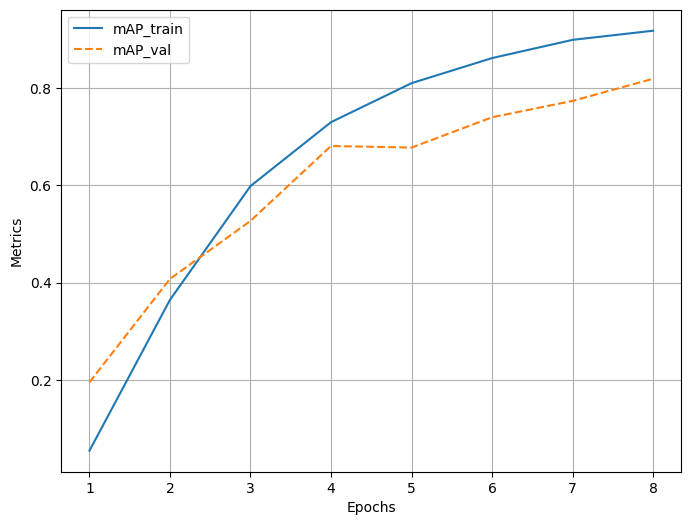

100%|██████████| 109/109 [00:00<00:00, 781.02it/s]


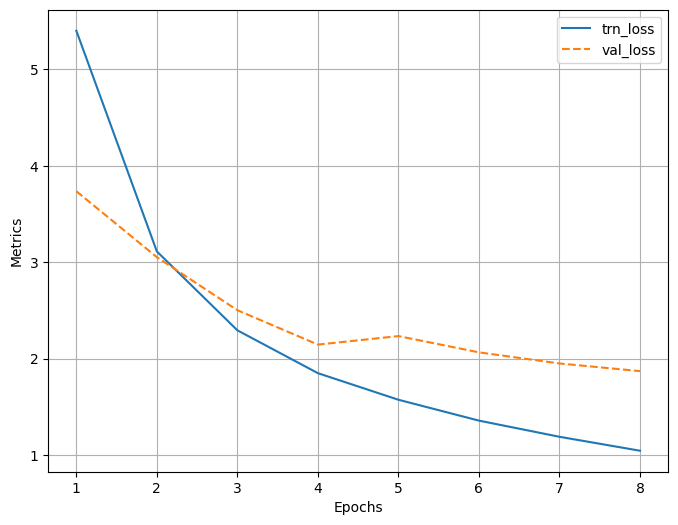

In [31]:
for epoch in range(n_epochs):
    _n = len(train_dl)
    for ix, inputs in enumerate(train_dl):
        loss,mAP = train_batch_mAP(inputs, model, criterion,optimizer)
        pos = (epoch + (ix+1)/_n)
        log.record(pos, trn_loss=loss.item(), mAP_train=mAP, end='\r')
    _n = len(val_dl)
    for ix,inputs in enumerate(val_dl):
        loss, mAP_v = validate_batch_mAP(inputs, model, criterion)
        pos = (epoch + (ix+1)/_n)
        log.record(pos, val_loss=loss.item(), mAP_val=mAP_v, end='\r')
    log.report_avgs(epoch+1)
    scheduler_1.step()
log.plot_epochs(['mAP_train','mAP_val'])
log.plot_epochs(['trn_loss', 'val_loss'])

# **15. Сохраняем/загружаем модель**

In [32]:
# save_path = 'ДИПЛОМ_6_3_SSD(итог_с_mAP)_САМОЛЕТЫ.pth'
# torch.save(model.state_dict(), save_path)
# !du -hsc {save_path} # size of the model on disk

In [33]:
# load_path = '/content/ДИПЛОМ_6_3_SSD(итог_с_mAP)_САМОЛЕТЫ.pth'
# model.load_state_dict(torch.load(load_path)) #  # строка при загрузке на GРU
# # model.load_state_dict(torch.load(load_path, map_location=torch.device('cpu'))) # строка при загрузке на СРU

# **16. Получаем коробки и классы для любой картинки в формате входящей картинки**

# **detect**

In [36]:
from torchvision import transforms
from PIL import Image, ImageDraw, ImageFont
from torch_snippets.loader import *

# Load model checkpoint
# checkpoint = 'checkpoint_ssd300.pth.tar'
# checkpoint = torch.load(checkpoint)
# start_epoch = checkpoint['epoch'] + 1
# print('\nLoaded checkpoint from epoch %d.\n' % start_epoch)
# model = checkpoint['model']

resize = transforms.Resize((300, 300))
to_tensor = transforms.ToTensor()
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])

def detect(original_image, model, min_score, max_overlap, top_k, device, suppress=None):
    image = normalize(to_tensor(resize(original_image))).to(device)
    regr_, clss_ = model(image[None])
    boxes, labels, confs = model.detect_objects(regr_, clss_,
                                                min_score=min_score,
                                                max_overlap=max_overlap, top_k=top_k)
    boxes = boxes[0].to('cpu')
    confs = [s.item() for s in confs[0]]
    original_dims = torch.FloatTensor([original_image.width, original_image.height, original_image.width, original_image.height])[None]
    bbs = boxes * original_dims
    bbs = bbs.cpu().detach().numpy().astype(np.int16).tolist()
    # labels = [rev_label_map[l] for l in labels[0].to('cpu').tolist()]
    labels = labels[0]
    return bbs, labels, confs

# if __name__ == '__main__':
#     img_path = '/media/ssd/ssd data/VOC2007/JPEGImages/000001.jpg'
#     original_image = Image.open(img_path, mode='r')
#     original_image = original_image.convert('RGB')
#     detect(original_image, min_score=0.2, max_overlap=0.5, top_k=200).show()


# **предсказания**

In [39]:
# image_paths = Glob('/kaggle/input/military-aircraft-recognition-dataset/JPEGImages/*')
# image_id = choose(val_ds.image_infos)
# img_path = find(image_id, val_ds.files)
# original_image = Image.open(img_path, mode='r')
# original_image = original_image.convert('RGB')

AttributeError: 'OpenDataset' object has no attribute 'files'

[[249, 467, 389, 619], [211, 611, 382, 741], [551, 530, 681, 660], [566, 394, 695, 524], [527, 665, 667, 789], [290, 340, 419, 474]] ['A3 @ 1.00', 'A3 @ 0.99', 'A3 @ 0.99', 'A3 @ 0.99', 'A3 @ 0.98', 'A3 @ 0.95']


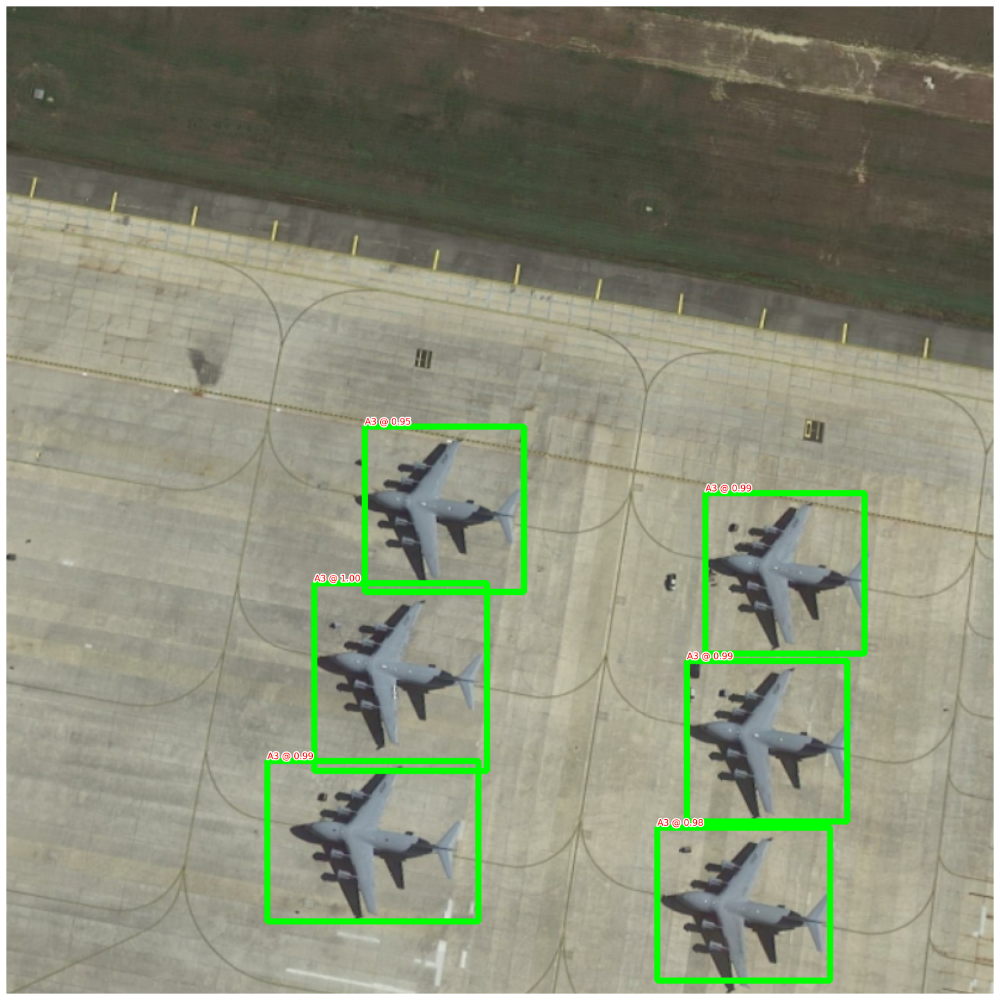

[[542, 19, 651, 120], [174, 619, 283, 710], [126, 162, 224, 267]] ['A10 @ 1.00', 'A10 @ 1.00', 'A10 @ 0.99']


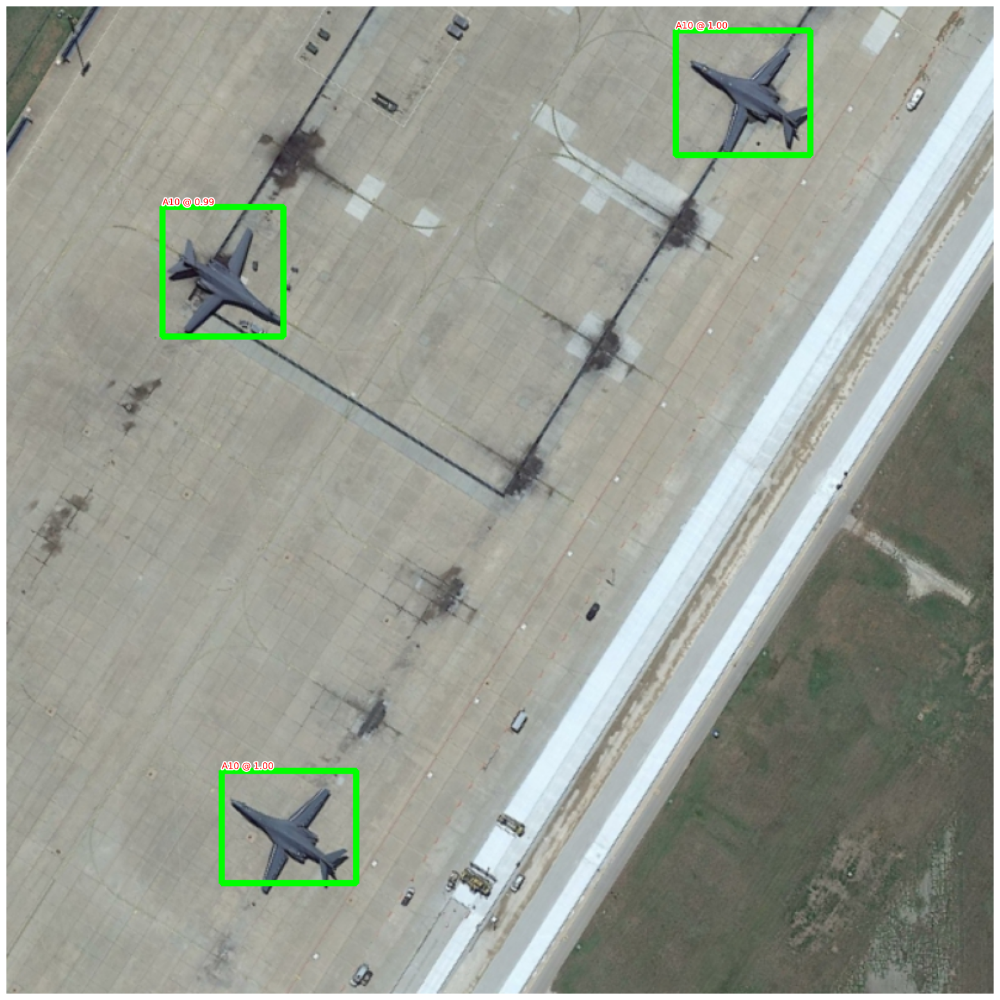

In [40]:
image_lst = ['/kaggle/input/military-aircraft-recognition-dataset/JPEGImages/1378.jpg',
             '/kaggle/input/military-aircraft-recognition-dataset/JPEGImages/1472.jpg']
# image_paths = Glob('/content/JPEGImages/*')
for _ in image_lst:
    # image_id = choose(val_ds.image_infos)
    # img_path = find(image_id, val_ds.files)
    original_image = Image.open(_, mode='r')
    bbs, labels, scores = detect(original_image, model, min_score=0.9, max_overlap=0.5,top_k=200, device=device)
    labels = [targets2label[c.item()] for c in labels]
    label_with_conf = [f'{l} @ {s:.2f}' for l,s in zip(labels,scores)]
    print(bbs, label_with_conf)
    show(original_image, bbs=bbs, texts=label_with_conf, text_sz=10)

# **КОНЕЦ!**